In [2]:
%matplotlib inline
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import json
from pandas.io.json import json_normalize #package for flattening json in pandas df
import matplotlib.pyplot as plt
from datetime import date, timedelta, datetime

In [3]:
import os
os.getcwd()

'C:\\Users\\Rockwell\\Documents\\GitHub\\Demand-Response'

# 1. Deal with load data

## We can find that TOU has complete data in 2013

In [3]:
df_tou = pd.read_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\consumption_d.csv")
df_tou

,GMT,D0000,D0001,D0002,D0003,D0004,D0005,D0006,D0007,D0008,...,D1015,D1016,D1017,D1018,D1019,D1020,D1021,D1022,D1023,D1024
0,2011-11-23 09:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2011-11-23 09:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2011-11-23 10:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2011-11-23 10:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2011-11-23 11:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2011-11-23 11:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2011-11-23 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2011-11-23 12:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2011-11-23 13:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2011-11-23 13:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## We need to extract all the TOU load data in 2013

In [4]:
df_tou_2013 = df_tou.loc[df_tou['GMT'].str[0:4] == '2013'].reset_index(drop = True)
# Store the complete dataframe to a csv file
df_tou_2013.to_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_tou2013.csv", index = False)
df_tou_2013

,GMT,D0000,D0001,D0002,D0003,D0004,D0005,D0006,D0007,D0008,...,D1015,D1016,D1017,D1018,D1019,D1020,D1021,D1022,D1023,D1024
0,2013-01-01 00:00:00,1.043,0.181,0.224,0.077,0.195,0.040,0.146,0.131,0.214,...,0.016,0.028,0.266,0.063,0.182,0.305,0.074,0.177,0.066,0.059
1,2013-01-01 00:30:00,0.404,0.248,0.227,0.078,0.202,0.066,0.161,0.137,0.176,...,0.032,0.005,0.236,0.054,0.196,0.838,0.081,0.166,0.110,0.058
2,2013-01-01 01:00:00,0.185,0.206,0.231,0.076,0.188,0.057,0.227,0.164,0.187,...,0.046,0.005,0.289,0.060,0.218,0.446,0.039,0.145,0.100,0.087
3,2013-01-01 01:30:00,0.151,0.171,0.236,0.077,0.039,0.052,0.138,0.136,0.341,...,0.016,0.005,0.239,0.057,0.181,0.410,0.059,0.133,0.234,0.040
4,2013-01-01 02:00:00,0.139,0.068,0.239,0.077,0.024,0.070,0.040,0.103,0.087,...,0.016,0.005,0.120,0.263,0.174,0.282,0.049,0.049,0.056,0.083
5,2013-01-01 02:30:00,0.105,0.083,0.251,0.077,0.102,0.038,0.020,0.094,0.063,...,0.016,0.005,0.097,0.047,0.188,0.239,0.034,0.039,0.106,0.053
6,2013-01-01 03:00:00,0.122,0.083,0.246,0.077,0.033,0.083,0.035,0.086,0.069,...,0.046,0.005,0.117,0.065,0.194,0.275,0.058,0.019,0.073,0.163
7,2013-01-01 03:30:00,0.091,0.072,0.334,0.076,0.024,0.026,0.032,0.081,0.082,...,0.016,0.006,0.089,0.054,0.174,0.195,0.055,0.042,0.054,0.084
8,2013-01-01 04:00:00,0.110,0.060,0.287,0.079,0.033,0.083,0.020,0.073,0.054,...,0.015,0.051,0.104,0.056,0.164,0.106,0.040,0.022,0.032,0.035
9,2013-01-01 04:30:00,0.100,0.061,0.292,0.077,0.028,0.024,0.036,0.071,0.079,...,0.046,0.045,0.378,0.062,0.190,0.140,0.057,0.036,0.007,0.039


In [5]:
# Now we compress the rows such that the frequency is 1 hour
# first let's delete the GMT index of matrix consists in odd rows
odd_df = df_tou_2013.loc[1::2].copy()
odd_df.loc[:, 'GMT'] = ''
# create the new dataframe that is the sum of odd and even rows
df_tou_2013_1h = (df_tou_2013[::2] + odd_df.values).reset_index(drop = True)
# store it to a csv file
df_tou_2013_1h.to_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_tou2013_1h.csv", index = False)

## We can find that non-TOU has complete data in 2013

In [6]:
df_ntou = pd.read_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\consumption_n.csv")
df_ntou

,GMT,N0000,N0001,N0002,N0003,N0004,N0005,N0006,N0007,N0008,...,N4163,N4164,N4165,N4166,N4167,N4168,N4169,N4170,N4171,N4172
0,2011-11-23 09:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2011-11-23 09:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2011-11-23 10:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2011-11-23 10:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2011-11-23 11:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2011-11-23 11:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2011-11-23 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2011-11-23 12:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2011-11-23 13:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2011-11-23 13:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## We then extract all the non-TOU load data in 2013 

In [7]:
df_ntou_2013 = df_ntou.loc[df_ntou['GMT'].str[0:4] == '2013'].reset_index(drop = True)
df_ntou_2013.to_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_Ntou2013.csv", index = False)
df_ntou_2013

,GMT,N0000,N0001,N0002,N0003,N0004,N0005,N0006,N0007,N0008,...,N4163,N4164,N4165,N4166,N4167,N4168,N4169,N4170,N4171,N4172
0,2013-01-01 00:00:00,0.306,0.117,0.018,0.140,0.090,0.369,0.000,0.077,0.170,...,0.125,0.003,0.044,0.010,0.338,0.099,0.028,0.152,0.054,0.081
1,2013-01-01 00:30:00,0.732,0.115,0.034,0.116,0.091,0.404,0.000,0.086,0.091,...,0.062,0.048,0.043,0.010,0.248,0.102,0.041,0.102,0.048,0.051
2,2013-01-01 01:00:00,0.250,0.152,0.051,0.092,0.092,0.245,0.000,0.082,0.047,...,0.132,0.014,0.042,0.020,0.263,0.093,0.034,0.055,0.082,0.092
3,2013-01-01 01:30:00,0.234,0.115,0.050,0.100,0.093,0.114,0.000,0.070,0.043,...,0.172,0.031,0.024,0.095,0.201,0.101,0.036,0.108,0.094,0.048
4,2013-01-01 02:00:00,0.214,0.114,0.048,0.100,0.108,0.059,0.000,0.085,0.096,...,0.214,0.011,0.042,0.215,0.072,0.114,0.040,0.053,0.096,0.084
5,2013-01-01 02:30:00,0.235,0.152,0.044,0.100,0.376,0.091,0.000,0.085,0.060,...,0.182,0.041,0.042,0.020,0.118,0.127,0.106,0.044,0.059,0.058
6,2013-01-01 03:00:00,0.182,0.116,0.017,0.133,0.059,0.077,0.000,0.072,0.039,...,0.181,0.056,0.028,0.010,0.095,0.097,0.182,0.073,0.047,0.077
7,2013-01-01 03:30:00,0.208,0.114,0.017,0.129,0.073,0.078,0.000,0.080,0.055,...,0.174,0.055,0.038,0.011,0.062,0.088,0.050,0.064,0.048,0.070
8,2013-01-01 04:00:00,0.318,0.153,0.016,0.120,0.092,0.091,0.000,0.086,0.075,...,0.167,0.097,0.042,0.010,0.060,0.218,0.038,0.044,0.047,0.056
9,2013-01-01 04:30:00,0.618,0.115,0.036,0.085,0.091,0.072,0.000,0.079,0.080,...,0.179,0.022,0.030,0.011,0.115,0.094,0.040,0.045,0.047,0.105


In [8]:
# Now we compress the rows such that the frequency is 1 hour
# first let's delete the GMT index of matrix consists in odd rows
odd_df_ntou = df_ntou_2013.loc[1::2].copy()
odd_df_ntou.loc[:, 'GMT'] = ''
# create the new dataframe that is the sum of odd and even rows
df_ntou_2013_1h = (df_ntou_2013[::2] + odd_df_ntou.values).reset_index(drop = True)
# store it to a csv file
df_ntou_2013_1h.to_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_Ntou2013_1h.csv", index = False)

# 2. Write a function that can extract all key values of data, time and weather to a csv file from London weather 2013

1) read txt data by line

2) extract the date and time and temperature out of it

3) store them to a dataframe

4) save the dataframe as csv file "London_weather.csv"

5) combine data frame of all months together

In [9]:
with open("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\weather\\LondonWeather2013_test.txt") as file_test:
    file_content = file_test.readlines()

In [10]:
weather_dict = {} # store the data in dictionary "time": "temperature"
for line in file_content:
    if ('"date":' in line) or ('"time":' in line) or ('"tempC":' in line) or ('"tempF":' in line):
        if '"date":' in line: # use the newest date
            newest_date = line.strip().strip('"date": ').strip(',').strip('"') # only keep date strings
        if '"time":' in line: # convert the time to form HH:MM:SS
            # clean the string
            cleaned_time = line.strip().strip('"time": ').strip(',').strip('"')
            if len(cleaned_time) == 1: # i.e. cleaned_time == '0'
                standard_time = '00:00:00'
            elif len(cleaned_time) == 3: # i.e. cleaned_time == '300' - '900' etc
                standard_time = '0' + cleaned_time[0] + ':' + '00:00'
            else:
                standard_time = cleaned_time[:2] + ':00:00'
            newest_key = newest_date + ' ' + standard_time
#             print(newest_key)
        if '"tempC":' in line: # store the tempC to the dictionary
            cleaned_tempC = line.strip().strip('"tempC": ').strip(',').strip('"')
        if '"tempF":' in line: # store the tempF to the dictionary
            cleaned_tempF = line.strip().strip('"tempF": ').strip(',').strip('"')
            weather_dict[newest_key] = [float(cleaned_tempC), float(cleaned_tempF)]
# print(weather_dict)

#convert the dictionary to dataframe
df_temp = pd.DataFrame.from_dict(weather_dict, orient = 'index', 
                                 columns = ['TempC', 'TempF'])
df_temp = df_temp.reset_index()
df_temp.rename(columns={'index' : 'GMT'})

,GMT,TempC,TempF
0,2013-01-01 00:00:00,7.0,45.0
1,2013-01-01 03:00:00,6.0,43.0
2,2013-01-01 06:00:00,4.0,38.0
3,2013-01-01 09:00:00,3.0,38.0
4,2013-01-01 12:00:00,6.0,43.0
5,2013-01-01 15:00:00,6.0,43.0
6,2013-01-01 18:00:00,4.0,39.0
7,2013-01-01 21:00:00,3.0,37.0
8,2013-01-02 00:00:00,2.0,36.0
9,2013-01-02 03:00:00,2.0,36.0


## Now let's make it to a function such that input is the file path and the output is a dataframe.

In [11]:
def temp_text_read(path):
    with open(path) as file_test:
        file_content = file_test.readlines()
    weather_dict = {} # store the data in dictionary "time": "temperature"
    for line in file_content:
        if ('"date":' in line) or ('"time":' in line) or ('"tempC":' in line) or ('"tempF":' in line):
            if '"date":' in line: # use the newest date
                newest_date = line.strip().strip('"date": ').strip(',').strip('"') # only keep date strings
            if '"time":' in line: # convert the time to form HH:MM:SS
                # clean the string
                cleaned_time = line.strip().strip('"time": ').strip(',').strip('"')
                if len(cleaned_time) == 1: # i.e. cleaned_time == '0'
                    standard_time = '00:00:00'
                elif len(cleaned_time) == 3: # i.e. cleaned_time == '300' - '900' etc
                    standard_time = '0' + cleaned_time[0] + ':' + '00:00'
                else:
                    standard_time = cleaned_time[:2] + ':00:00'
                newest_key = newest_date + ' ' + standard_time
    #             print(newest_key)
            if '"tempC":' in line: # store the tempC to the dictionary
                cleaned_tempC = line.strip().strip('"tempC": ').strip(',').strip('"')
            if '"tempF":' in line: # store the tempF to the dictionary
                cleaned_tempF = line.strip().strip('"tempF": ').strip(',').strip('"')
                weather_dict[newest_key] = [float(cleaned_tempC), float(cleaned_tempF)]
    # print(weather_dict)

    #convert the dictionary to dataframe
    df_temp = pd.DataFrame.from_dict(weather_dict, orient = 'index', 
                                     columns = ['TempC', 'TempF'])
    df_temp = df_temp.reset_index()
    df_temp = df_temp.rename(columns={'index' : 'GMT'})
    return df_temp # a dataframe of GMT time and the corresponding temperature (C and F)

In [12]:
file_path = "C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\weather\\LondonWeather2013_test.txt"
temp_text_read(file_path)

,GMT,TempC,TempF
0,2013-01-01 00:00:00,7.0,45.0
1,2013-01-01 03:00:00,6.0,43.0
2,2013-01-01 06:00:00,4.0,38.0
3,2013-01-01 09:00:00,3.0,38.0
4,2013-01-01 12:00:00,6.0,43.0
5,2013-01-01 15:00:00,6.0,43.0
6,2013-01-01 18:00:00,4.0,39.0
7,2013-01-01 21:00:00,3.0,37.0
8,2013-01-02 00:00:00,2.0,36.0
9,2013-01-02 03:00:00,2.0,36.0


## Now process a batch of such files in 2013 and concatinate them together to store in a CSV file and a dataframe table.

In [13]:
pd.DataFrame(columns = ['GMT', 'TempC', 'TempF'])

,GMT,TempC,TempF


In [14]:
# Create an empty dataframe
df = pd.DataFrame(columns = ['GMT', 'TempC', 'TempF'])

# Concatinate all dataframes that are read from json text files
for i in range(12):
    new_path = "C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\weather\\LondonWeather2013_" + str(i+1) + '.txt'
    # Concatinate all and delete the repetitive rows
    df = pd.concat([df, temp_text_read(new_path)]).drop_duplicates().reset_index(drop = True)

# Store the complete dataframe to a csv file
df.to_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\weather\\LondonWeather2013_complete.csv", index = False)

## We also want to interpolate data in each 3-hour interval, so that data is with 1-hour frequency. For this project, we use linear interpolation.

In [15]:
# First we construct a new dataframe that has GMT time column with 1-hour frequency.
weather_dict_extend = {}

start_date = date(2013, 1, 1)
end_date = date(2013,12,31)
# int(end_date - start_date)
date_span = int((end_date - start_date).days + 1)
for day in range(date_span):
    new_date = start_date + timedelta(day)
    day_str = new_date.strftime("%Y-%m-%d")
#     print(day_str)
    # repeat over all hours of a day
    for hour in range(24):
        if hour in range(10):
            hour_str = ' 0' + str(hour) + ':00:00'
        else:
            hour_str = ' ' + str(hour) + ':00:00'
        new_index = day_str + hour_str
        weather_dict_extend[new_index] = [None, None]

# we now get the extend dict and let's convert it to dataframe
# print(weather_dict_extend)
df_interp = pd.DataFrame.from_dict(weather_dict_extend, orient = 'index', 
                                     columns = ['TempC', 'TempF'])
df_interp = df_interp.reset_index()
df_interp = df_interp.rename(columns={'index' : 'GMT'})

## Having the extended empty dataframe, we can now do interpolation with the previous df.

In [16]:
for i in range(len(df) - 1):
    df_interp['TempC'][3 * i] = df['TempC'][i]
    df_interp['TempC'][3 * i + 1] = df['TempC'][i] + (df['TempC'][i + 1] - df['TempC'][i]) / 3
    df_interp['TempC'][3 * i + 2] = df['TempC'][i] + 2 * (df['TempC'][i + 1] - df['TempC'][i]) / 3

    df_interp['TempF'][3 * i] = df['TempF'][i]
    df_interp['TempF'][3 * i + 1] = df['TempF'][i] + (df['TempF'][i + 1] - df['TempF'][i]) / 3
    df_interp['TempF'][3 * i + 2] = df['TempF'][i] + 2 * (df['TempF'][i + 1] - df['TempF'][i]) / 3
    
#for the last interpolation, we just simply keep it as the same as the previous data
df_interp['TempC'][3 * (len(df) - 1)] = df['TempC'][len(df) - 1]
df_interp['TempC'][3 * (len(df) - 1) + 1] = df['TempC'][len(df) - 1]
df_interp['TempC'][3 * (len(df) - 1) + 2] = df['TempC'][len(df) - 1]

df_interp['TempF'][3 * (len(df) - 1)] = df['TempF'][len(df) - 1]
df_interp['TempF'][3 * (len(df) - 1) + 1] = df['TempF'][len(df) - 1]
df_interp['TempF'][3 * (len(df) - 1) + 2] = df['TempF'][len(df) - 1]

#store the interpolated data into a csv file
# Store the complete dataframe to a csv file
df_interp.to_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\weather\\LondonWeather2013_interpolated.csv", index = False)
df_interp

,GMT,TempC,TempF
0,2013-01-01 00:00:00,7,45
1,2013-01-01 01:00:00,6.66667,44.3333
2,2013-01-01 02:00:00,6.33333,43.6667
3,2013-01-01 03:00:00,6,43
4,2013-01-01 04:00:00,5.33333,41.3333
5,2013-01-01 05:00:00,4.66667,39.6667
6,2013-01-01 06:00:00,4,38
7,2013-01-01 07:00:00,3.66667,38
8,2013-01-01 08:00:00,3.33333,38
9,2013-01-01 09:00:00,3,38


# 3. With all the data available, we can visualize load and temperature over time in each month and observe the trend of these curves. (Maybe find some cycles of certain properties)

## The data for TOU
C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_tou2013_1h.csv
## The data for non-TOU
C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_Ntou2013_1h.csv
## The data for weather
C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\weather\\LondonWeather2013_interpolated.csv

In [3]:
df_tou1h = pd.read_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_tou2013_1h.csv")
df_Ntou1h = pd.read_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_Ntou2013_1h.csv")
df_wea1h = pd.read_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\weather\\LondonWeather2013_interpolated.csv")

In [3]:
print(df_tou1h.shape)
print(df_Ntou1h.shape)
print(df_wea1h.shape)

(8760, 1026)
(8760, 4174)
(8760, 3)


## We can check the relationship between average energy consumption and outside temperature. (for the non-TOU case)

In [4]:
# Let's first create two new columns that is the total and average energy consumptions over all users to df_Ntou1h
totalHourly = df_Ntou1h.sum(1)
df_Ntou1h['Total'] = totalHourly
df_Ntou1h['Average'] = totalHourly / (df_Ntou1h.shape[1] - 2) # Delete the first GMT column and the Total column just added
df_Ntou1h.head()

,GMT,N0000,N0001,N0002,N0003,N0004,N0005,N0006,N0007,N0008,...,N4165,N4166,N4167,N4168,N4169,N4170,N4171,N4172,Total,Average
0,2013-01-01 00:00:00,1.038,0.232,0.052,0.256,0.181,0.773,0.0,0.163,0.261,...,0.087,0.020,0.586,0.201,0.069,0.254,0.102,0.132,1795.373,0.430236
1,2013-01-01 01:00:00,0.484,0.267,0.101,0.192,0.185,0.359,0.0,0.152,0.090,...,0.066,0.115,0.464,0.194,0.070,0.163,0.176,0.140,1529.543,0.366533
2,2013-01-01 02:00:00,0.449,0.266,0.092,0.200,0.484,0.150,0.0,0.170,0.156,...,0.084,0.235,0.190,0.241,0.146,0.097,0.155,0.142,1306.862,0.313171
3,2013-01-01 03:00:00,0.390,0.230,0.034,0.262,0.132,0.155,0.0,0.152,0.094,...,0.066,0.021,0.157,0.185,0.232,0.137,0.095,0.147,1118.956,0.268142
4,2013-01-01 04:00:00,0.936,0.268,0.052,0.205,0.183,0.163,0.0,0.165,0.155,...,0.072,0.021,0.175,0.312,0.078,0.089,0.094,0.161,1014.649,0.243146


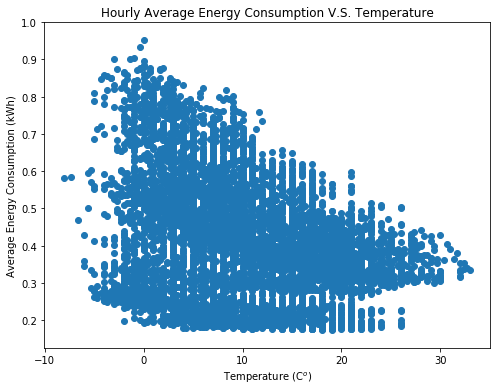

In [7]:
# from IPython.core.display import HTML
# HTML("""
# <style>
# .output_png {
#     display: flex;
#     text-align: center;
#     vertical-align: center;
#     align-items: center;
# }
# </style>
# """)

plt.figure(figsize = (8, 6))
plt.scatter(df_wea1h.TempC, df_Ntou1h.Average)
plt.xlabel(r'Temperature (C$^o$)')
plt.ylabel('Average Energy Consumption (kWh)')
plt.title('Hourly Average Energy Consumption V.S. Temperature')
plt.show()


## But what if we check the relationship between the average energy consumption and outside temperature at each hour of a day. (for the non-TOU case)
For example, 9:00 am average energy consumption and outside temperature over 365 days. 

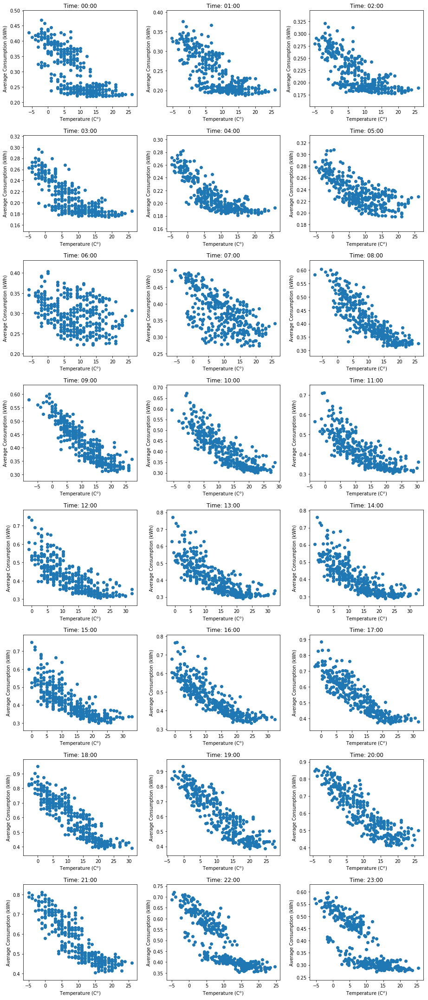

In [8]:
# Show the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        ax.scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')], df_Ntou1h.Average[df_Ntou1h.GMT.str.contains('0' + str(i) + ':00:00')] )
        ax.set_title('Time: 0' + str(i) + ':00')
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Average Consumption (kWh)')
    else:
        ax.scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains(str(i) + ':00:00')], df_Ntou1h.Average[df_Ntou1h.GMT.str.contains(str(i) + ':00:00')] )
        ax.set_title('Time: ' + str(i) + ':00')
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Average Consumption (kWh)')
plt.tight_layout()

## Let's take a look at the relationship for TOU case

In [5]:
# Let's first create two new columns that is the total and average energy consumptions over all users to df_tou1h
totalHourly = df_tou1h.sum(1)
df_tou1h['Total'] = totalHourly
df_tou1h['Average'] = totalHourly / (df_tou1h.shape[1] - 2) # Delete the first GMT column and the Total column just added
df_tou1h.head()

,GMT,D0000,D0001,D0002,D0003,D0004,D0005,D0006,D0007,D0008,...,D1017,D1018,D1019,D1020,D1021,D1022,D1023,D1024,Total,Average
0,2013-01-01 00:00:00,1.447,0.429,0.451,0.155,0.397,0.106,0.307,0.268,0.390,...,0.502,0.117,0.378,1.143,0.155,0.343,0.176,0.117,424.283,0.413935
1,2013-01-01 01:00:00,0.336,0.377,0.467,0.153,0.227,0.109,0.365,0.300,0.528,...,0.528,0.117,0.399,0.856,0.098,0.278,0.334,0.127,362.458,0.353618
2,2013-01-01 02:00:00,0.244,0.151,0.490,0.154,0.126,0.108,0.060,0.197,0.150,...,0.217,0.310,0.362,0.521,0.083,0.088,0.162,0.136,301.792,0.294431
3,2013-01-01 03:00:00,0.213,0.155,0.580,0.153,0.057,0.109,0.067,0.167,0.151,...,0.206,0.119,0.368,0.470,0.113,0.061,0.127,0.247,268.945,0.262385
4,2013-01-01 04:00:00,0.210,0.121,0.579,0.156,0.061,0.107,0.056,0.144,0.133,...,0.482,0.118,0.354,0.246,0.097,0.058,0.039,0.074,240.464,0.234599


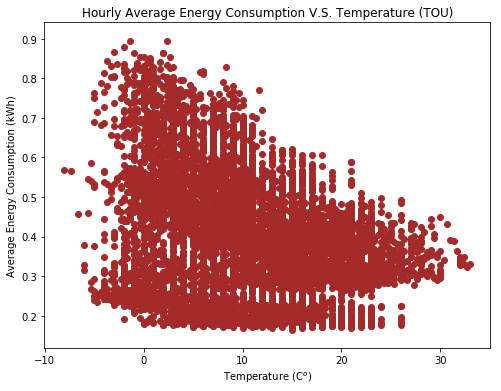

In [10]:
plt.figure(figsize = (8, 6))
plt.scatter(df_wea1h.TempC, df_tou1h.Average, c = 'brown')
plt.xlabel(r'Temperature (C$^o$)')
plt.ylabel('Average Energy Consumption (kWh)')
plt.title('Hourly Average Energy Consumption V.S. Temperature (TOU)')
plt.show()

## Similarly, if we check the relationship between the average energy consumption and outside temperature at each hour of a day. (for the TOU case)
For example, 9:00 am average energy consumption and outside temperature over 365 days. 

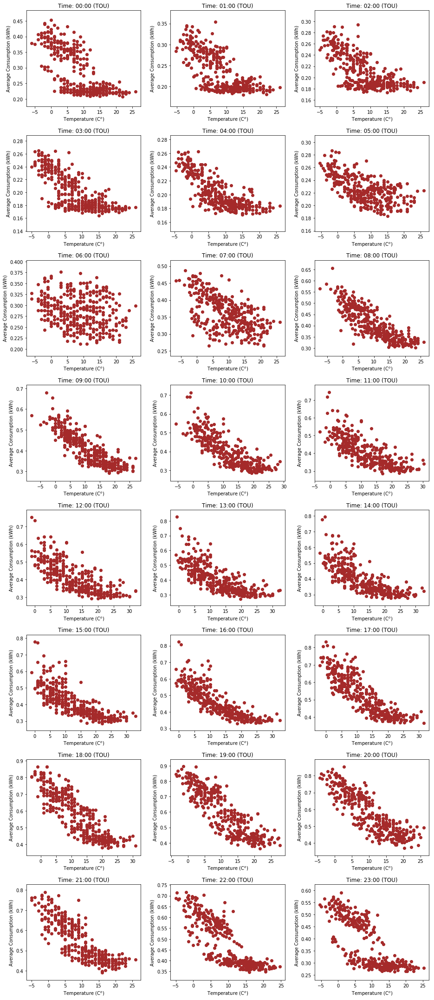

In [11]:
# Show the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        ax.scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')], df_tou1h.Average[df_tou1h.GMT.str.contains('0' + str(i) + ':00:00')],  c = 'brown' )
        ax.set_title('Time: 0' + str(i) + ':00 (TOU)')
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Average Consumption (kWh)')
    else:
        ax.scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains(str(i) + ':00:00')], df_tou1h.Average[df_tou1h.GMT.str.contains(str(i) + ':00:00')], c = 'brown' )
        ax.set_title('Time: ' + str(i) + ':00 (TOU)')
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Average Consumption (kWh)')
plt.tight_layout()

## Let's compare these two cases, i.e. non-TOU vs TOU

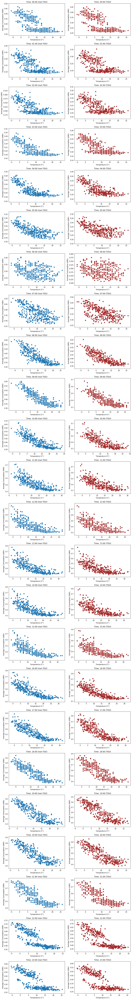

In [12]:
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + 1))
    if i <= 9:
        ax_Ntou[-1].scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')], df_Ntou1h.Average[df_Ntou1h.GMT.str.contains('0' + str(i) + ':00:00')] )
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
    else:
        ax_Ntou[-1].scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains(str(i) + ':00:00')], df_Ntou1h.Average[df_Ntou1h.GMT.str.contains(str(i) + ':00:00')] )
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
for i in range(24):
    ax_tou.append(fig_all.add_subplot(24, 2, 2 * i + 2))
    if i <= 9:
        ax_tou[-1].scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')], df_tou1h.Average[df_tou1h.GMT.str.contains('0' + str(i) + ':00:00')],  c = 'brown' )
        ax_tou[-1].set_title('Time: 0' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
    else:
        ax_tou[-1].scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains(str(i) + ':00:00')], df_tou1h.Average[df_tou1h.GMT.str.contains(str(i) + ':00:00')], c = 'brown' )
        ax_tou[-1].set_title('Time: ' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
plt.tight_layout()

In [13]:
# # Baisc one without creating axes lists, used for future reference.
# for i in range(24):
#     ax = fig_all.add_subplot(24, 2, 2 * i + 1)
#     if i <= 9:
#         ax.scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')], df_Ntou1h.Average[df_Ntou1h.GMT.str.contains('0' + str(i) + ':00:00')] )
#         ax.set_title('Time: 0' + str(i) + ':00 (non-TOU)')
#         ax.set_xlabel(r'Temperature (C$^o$)')
#         ax.set_ylabel('Average Consumption (kWh)')
#     else:
#         ax.scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains(str(i) + ':00:00')], df_Ntou1h.Average[df_Ntou1h.GMT.str.contains(str(i) + ':00:00')] )
#         ax.set_title('Time: ' + str(i) + ':00 (non-TOU)')
#         ax.set_xlabel(r'Temperature (C$^o$)')
#         ax.set_ylabel('Average Consumption (kWh)')
# for i in range(24):
#     ax = fig_all.add_subplot(24, 2, 2 * i + 2)
#     if i <= 9:
#         ax.scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')], df_tou1h.Average[df_tou1h.GMT.str.contains('0' + str(i) + ':00:00')],  c = 'brown' )
#         ax.set_title('Time: 0' + str(i) + ':00 (TOU)')
#         ax.set_xlabel(r'Temperature (C$^o$)')
#         ax.set_ylabel('Average Consumption (kWh)')
#     else:
#         ax.scatter(df_wea1h.TempC[df_wea1h.GMT.str.contains(str(i) + ':00:00')], df_tou1h.Average[df_tou1h.GMT.str.contains(str(i) + ':00:00')], c = 'brown' )
#         ax.set_title('Time: ' + str(i) + ':00 (TOU)')
#         ax.set_xlabel(r'Temperature (C$^o$)')
#         ax.set_ylabel('Average Consumption (kWh)')
# plt.tight_layout()

## The correlation of average consumption and temperature is given below

In [14]:
def highlight_max(s):
    '''
    highlight the maximum in a Series yellow.
    '''
    is_max = s == s.max()
    return ['background-color: yellow' if v else '' for v in is_max]

In [15]:
# Let's first add correlation of average consumption and temperature on each plot
corr_nTou = []
corr_Tou = []
time_list = []
for i in range(24):
    if i <= 9:
        corr_nTou.append(np.corrcoef(df_wea1h.TempC[df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')], df_Ntou1h.Average[df_Ntou1h.GMT.str.contains('0' + str(i) + ':00:00')])[0][1])
        corr_Tou.append(np.corrcoef(df_wea1h.TempC[df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')], df_tou1h.Average[df_tou1h.GMT.str.contains('0' + str(i) + ':00:00')])[0][1])
        time_list.append('0' + str(i) + ':00:00')
    else:
        corr_nTou.append(np.corrcoef(df_wea1h.TempC[df_wea1h.GMT.str.contains(str(i) + ':00:00')], df_Ntou1h.Average[df_Ntou1h.GMT.str.contains(str(i) + ':00:00')])[0][1])
        corr_Tou.append(np.corrcoef(df_wea1h.TempC[df_wea1h.GMT.str.contains(str(i) + ':00:00')], df_tou1h.Average[df_tou1h.GMT.str.contains(str(i) + ':00:00')])[0][1])
        time_list.append(str(i) + ':00:00')
corr_dict = {}
corr_dict['Time'] = time_list
corr_dict['Non-TOU'] = corr_nTou
corr_dict['TOU'] = corr_Tou
df_corr = pd.DataFrame(corr_dict)
print("The correlation between average consumption and temperature ")
df_corr.style.apply(highlight_max)

The correlation between average consumption and temperature 


,Time,Non-TOU,TOU
0,00:00:00,-0.750935,-0.719511
1,01:00:00,-0.742681,-0.708529
2,02:00:00,-0.749275,-0.701912
3,03:00:00,-0.768477,-0.733397
4,04:00:00,-0.805196,-0.779261
5,05:00:00,-0.686257,-0.618888
6,06:00:00,-0.326638,-0.236381
7,07:00:00,-0.607173,-0.586979
8,08:00:00,-0.856065,-0.842754
9,09:00:00,-0.896261,-0.863859


## Fix the temperature and calculate mean of the data to see if there are difference between TOU and non-TOU case

In [6]:
# Combine the temperature dataframe and non-TOU and TOU data together, to construct 2 new combined dataframe
df_Ntou1h['TempC'] = df_wea1h['TempC'].round()
df_tou1h['TempC'] = df_wea1h['TempC'].round()
df_Ntou1h.groupby('TempC')['Total'].mean()

TempC
-8.0     2422.617000
-7.0     2194.779500
-6.0     1859.903200
-5.0     1922.399167
-4.0     1813.153615
-3.0     1755.657652
-2.0     1853.209401
-1.0     1829.753208
 0.0     2043.474169
 1.0     2165.431803
 2.0     2070.932192
 3.0     1974.060900
 4.0     1906.644273
 5.0     1866.607695
 6.0     1782.732955
 7.0     1798.756414
 8.0     1761.014519
 9.0     1705.896461
 10.0    1681.594872
 11.0    1598.153580
 12.0    1464.691083
 13.0    1506.845987
 14.0    1492.618108
 15.0    1504.134397
 16.0    1480.637633
 17.0    1471.391500
 18.0    1486.999506
 19.0    1477.559386
 20.0    1436.509478
 21.0    1431.052278
 22.0    1422.638348
 23.0    1400.771698
 24.0    1422.030135
 25.0    1479.400702
 26.0    1402.175564
 27.0    1494.972879
 28.0    1512.884583
 29.0    1473.826500
 30.0    1395.854500
 31.0    1617.117667
 32.0    1424.387750
 33.0    1410.085500
Name: Total, dtype: float64

In [17]:
df_NdVSt = df_Ntou1h[df_Ntou1h.GMT.str.contains('0' + str(2) + ':00:00')]
df_NdVSt = pd.DataFrame(df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4))
df_NdVSt = df_NdVSt.reset_index()

In [12]:
df_Ntou1h.head()

,GMT,N0000,N0001,N0002,N0003,N0004,N0005,N0006,N0007,N0008,...,N4166,N4167,N4168,N4169,N4170,N4171,N4172,Total,Average,TempC
0,2013-01-01 00:00:00,1.038,0.232,0.052,0.256,0.181,0.773,0.0,0.163,0.261,...,0.020,0.586,0.201,0.069,0.254,0.102,0.132,1795.373,0.430236,7.0
1,2013-01-01 01:00:00,0.484,0.267,0.101,0.192,0.185,0.359,0.0,0.152,0.090,...,0.115,0.464,0.194,0.070,0.163,0.176,0.140,1529.543,0.366533,7.0
2,2013-01-01 02:00:00,0.449,0.266,0.092,0.200,0.484,0.150,0.0,0.170,0.156,...,0.235,0.190,0.241,0.146,0.097,0.155,0.142,1306.862,0.313171,6.0
3,2013-01-01 03:00:00,0.390,0.230,0.034,0.262,0.132,0.155,0.0,0.152,0.094,...,0.021,0.157,0.185,0.232,0.137,0.095,0.147,1118.956,0.268142,6.0
4,2013-01-01 04:00:00,0.936,0.268,0.052,0.205,0.183,0.163,0.0,0.165,0.155,...,0.021,0.175,0.312,0.078,0.089,0.094,0.161,1014.649,0.243146,5.0


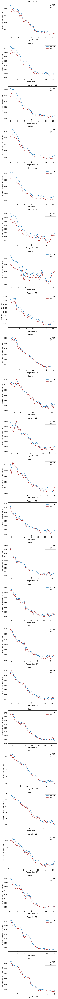

In [18]:
# non-TOU vs TOU in terms of average (over both users and the time) hourly energy consumption v.s. temperature
fig_all = plt.figure(figsize = (6,100))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 1, i+1))
    if i <= 9:
        # calculate the average consumption grouped by different temperatures
        df_NdVSt = df_Ntou1h[df_Ntou1h.GMT.str.contains('0' + str(i) + ':00:00')] #non-tou demand vs temperature
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total, label = 'non-TOU' )
        df_dVSt = df_tou1h[df_tou1h.GMT.str.contains('0' + str(i) + ':00:00')]
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'brown', label = 'TOU' )
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        df_NdVSt = df_Ntou1h[df_Ntou1h.GMT.str.contains(str(i) + ':00:00')]
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total, label = 'non-TOU')
        df_dVSt = df_tou1h[df_tou1h.GMT.str.contains(str(i) + ':00:00')]
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'brown', label = 'TOU' )
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
plt.tight_layout()

## Add linear and polynomial regression, and see which results in a less MSE.

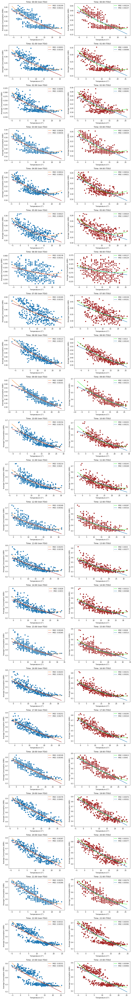

In [20]:
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
lm = LinearRegression()
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + 1))
    if i <= 9:
        x = df_wea1h.TempC[df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_Ntou1h.Average[df_Ntou1h.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        x = df_wea1h.TempC[df_wea1h.GMT.str.contains(str(i) + ':00:00')].values
        y = df_Ntou1h.Average[df_Ntou1h.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
for i in range(24):
    ax_tou.append(fig_all.add_subplot(24, 2, 2 * i + 2))
    if i <= 9:
        x = df_wea1h.TempC[df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_tou1h.Average[df_tou1h.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: 0' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
    else:
        x = df_wea1h.TempC[df_wea1h.GMT.str.contains(str(i) + ':00:00')].values
        y = df_tou1h.Average[df_tou1h.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: ' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
plt.tight_layout()

## Monthly characteristics
Notice that these data points have certain gaps, especially for 22:00 to 04:00. So we wonder if that's due to seasonal effects.
London seasons are listed below:
Spring (March - May), Summer (June - August), Autumn (September - November), and Winter (December - February)

In [7]:
# Read the tariff data
df_tariff = pd.read_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\tariff_d.csv")

# Shift the Price and Events Column up by 1 row (30min)
df_tariff.Price = df_tariff.Price.shift(-1)
df_tariff.Event_tags = df_tariff.Event_tags.shift(-1)

# Add the first row as starting from '2013-01-01 00:00:00'
new_row = pd.DataFrame({'GMT' : ['2013-01-01 00:00:00'],
                       'Price' : [np.float64(0.1176)],
                       'Event_tags' : float('nan')})
df_tariff_edited = pd.concat([new_row, df_tariff], ignore_index = True)[:-11]

# make the frequency to one hour
df_tariff_1h = df_tariff_edited[::2].reset_index(drop = True)
df_tariff_1h.to_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\df_tariff_1h.csv", index = False)

In [14]:
# Create Spring, Summer, Autumn and Winter dataframe for load, price, weather
spring = [3, 4, 5]
summer = [6, 7, 8]
autumn = [9, 10, 11]
winter = [12, 1, 2]
df_month_help = pd.DataFrame(pd.to_datetime(df_tariff_1h.GMT).dt.month)
df_wea1h_spring = df_wea1h[df_month_help['GMT'].isin(spring)]
df_wea1h_summer = df_wea1h[df_month_help['GMT'].isin(summer)]
df_wea1h_autumn = df_wea1h[df_month_help['GMT'].isin(autumn)]
df_wea1h_winter = df_wea1h[df_month_help['GMT'].isin(winter)]

df_tou1h_spring = df_tou1h[df_month_help['GMT'].isin(spring)]
df_tou1h_summer = df_tou1h[df_month_help['GMT'].isin(summer)]
df_tou1h_autumn = df_tou1h[df_month_help['GMT'].isin(autumn)]
df_tou1h_winter = df_tou1h[df_month_help['GMT'].isin(winter)]

df_Ntou1h_spring = df_Ntou1h[df_month_help['GMT'].isin(spring)]
df_Ntou1h_summer = df_Ntou1h[df_month_help['GMT'].isin(summer)]
df_Ntou1h_autumn = df_Ntou1h[df_month_help['GMT'].isin(autumn)]
df_Ntou1h_winter = df_Ntou1h[df_month_help['GMT'].isin(winter)]

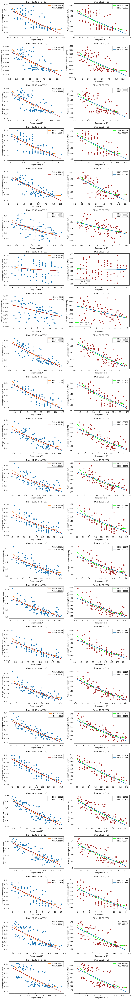

In [19]:
# Spring scatterplot of average consumption (over all consumers at same time period) vs. temp
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
lm = LinearRegression()
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + 1))
    if i <= 9:
        x = df_wea1h_spring.TempC[df_wea1h_spring.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_Ntou1h_spring.Average[df_Ntou1h_spring.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        x = df_wea1h_spring.TempC[df_wea1h_spring.GMT.str.contains(str(i) + ':00:00')].values
        y = df_Ntou1h_spring.Average[df_Ntou1h_spring.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
for i in range(24):
    ax_tou.append(fig_all.add_subplot(24, 2, 2 * i + 2))
    if i <= 9:
        x = df_wea1h_spring.TempC[df_wea1h_spring.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_tou1h_spring.Average[df_tou1h_spring.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: 0' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
    else:
        x = df_wea1h_spring.TempC[df_wea1h_spring.GMT.str.contains(str(i) + ':00:00')].values
        y = df_tou1h_spring.Average[df_tou1h_spring.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: ' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
plt.tight_layout()

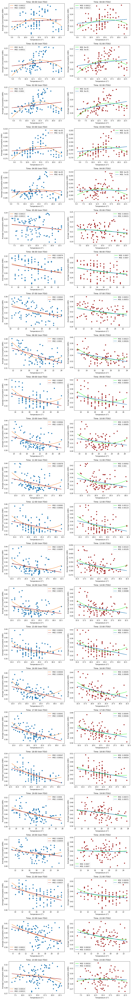

In [20]:
# Summer scatterplot of average consumption (over all consumers at same time period) vs. temp
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
lm = LinearRegression()
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + 1))
    if i <= 9:
        x = df_wea1h_summer.TempC[df_wea1h_summer.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_Ntou1h_summer.Average[df_Ntou1h_summer.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        x = df_wea1h_summer.TempC[df_wea1h_summer.GMT.str.contains(str(i) + ':00:00')].values
        y = df_Ntou1h_summer.Average[df_Ntou1h_summer.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
for i in range(24):
    ax_tou.append(fig_all.add_subplot(24, 2, 2 * i + 2))
    if i <= 9:
        x = df_wea1h_summer.TempC[df_wea1h_summer.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_tou1h_summer.Average[df_tou1h_summer.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: 0' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
    else:
        x = df_wea1h_summer.TempC[df_wea1h_summer.GMT.str.contains(str(i) + ':00:00')].values
        y = df_tou1h_summer.Average[df_tou1h_summer.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: ' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
plt.tight_layout()

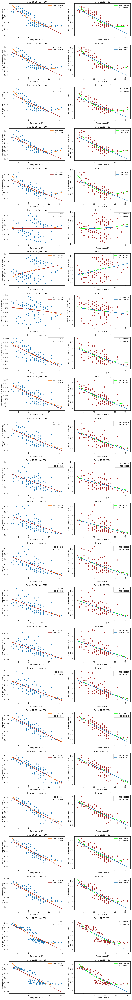

In [21]:
# Autumn scatterplot of average consumption (over all consumers at same time period) vs. temp
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
lm = LinearRegression()
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + 1))
    if i <= 9:
        x = df_wea1h_autumn.TempC[df_wea1h_autumn.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_Ntou1h_autumn.Average[df_Ntou1h_autumn.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        x = df_wea1h_autumn.TempC[df_wea1h_autumn.GMT.str.contains(str(i) + ':00:00')].values
        y = df_Ntou1h_autumn.Average[df_Ntou1h_autumn.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
for i in range(24):
    ax_tou.append(fig_all.add_subplot(24, 2, 2 * i + 2))
    if i <= 9:
        x = df_wea1h_autumn.TempC[df_wea1h_autumn.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_tou1h_autumn.Average[df_tou1h_autumn.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: 0' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
    else:
        x = df_wea1h_autumn.TempC[df_wea1h_autumn.GMT.str.contains(str(i) + ':00:00')].values
        y = df_tou1h_autumn.Average[df_tou1h_autumn.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: ' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
plt.tight_layout()

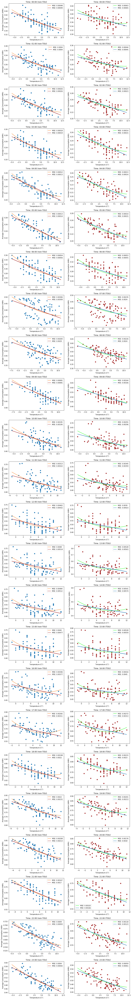

In [23]:
# Winter scatterplot of average consumption (over all consumers at same time period) vs. temp
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
lm = LinearRegression()
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + 1))
    if i <= 9:
        x = df_wea1h_winter.TempC[df_wea1h_winter.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_Ntou1h_winter.Average[df_Ntou1h_winter.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        x = df_wea1h_winter.TempC[df_wea1h_winter.GMT.str.contains(str(i) + ':00:00')].values
        y = df_Ntou1h_winter.Average[df_Ntou1h_winter.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
for i in range(24):
    ax_tou.append(fig_all.add_subplot(24, 2, 2 * i + 2))
    if i <= 9:
        x = df_wea1h_winter.TempC[df_wea1h_winter.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_tou1h_winter.Average[df_tou1h_winter.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: 0' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
    else:
        x = df_wea1h_winter.TempC[df_wea1h_winter.GMT.str.contains(str(i) + ':00:00')].values
        y = df_tou1h_winter.Average[df_tou1h_winter.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: ' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
plt.tight_layout()

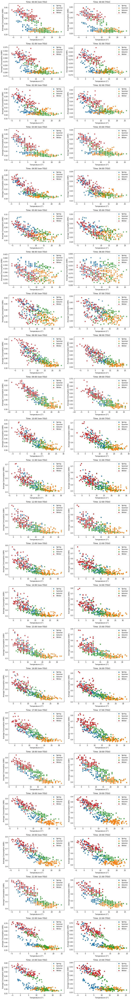

In [29]:
# Overview of the four seasons in the plot
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
lm = LinearRegression()
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + 1))
    if i <= 9:
        x = df_wea1h_spring.TempC[df_wea1h_spring.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_Ntou1h_spring.Average[df_Ntou1h_spring.GMT.str.contains('0' + str(i) + ':00:00')].values
        ax_Ntou[-1].scatter(x, y, label = 'Spring', alpha = 0.8)
        x = df_wea1h_summer.TempC[df_wea1h_summer.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_Ntou1h_summer.Average[df_Ntou1h_summer.GMT.str.contains('0' + str(i) + ':00:00')].values
        ax_Ntou[-1].scatter(x, y, label = 'Summer', alpha = 0.8)
        x = df_wea1h_autumn.TempC[df_wea1h_autumn.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_Ntou1h_autumn.Average[df_Ntou1h_autumn.GMT.str.contains('0' + str(i) + ':00:00')].values
        ax_Ntou[-1].scatter(x, y, label = 'Autumn', alpha = 0.8)
        x = df_wea1h_winter.TempC[df_wea1h_winter.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_Ntou1h_winter.Average[df_Ntou1h_winter.GMT.str.contains('0' + str(i) + ':00:00')].values
        ax_Ntou[-1].scatter(x, y, label = 'Winter', alpha = 0.8)
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        x = df_wea1h_spring.TempC[df_wea1h_spring.GMT.str.contains(str(i) + ':00:00')].values
        y = df_Ntou1h_spring.Average[df_Ntou1h_spring.GMT.str.contains(str(i) + ':00:00')].values
        ax_Ntou[-1].scatter(x, y, label = 'Spring', alpha = 0.8)
        x = df_wea1h_summer.TempC[df_wea1h_summer.GMT.str.contains(str(i) + ':00:00')].values
        y = df_Ntou1h_summer.Average[df_Ntou1h_summer.GMT.str.contains(str(i) + ':00:00')].values
        ax_Ntou[-1].scatter(x, y, label = 'Summer', alpha = 0.8)
        x = df_wea1h_autumn.TempC[df_wea1h_autumn.GMT.str.contains(str(i) + ':00:00')].values
        y = df_Ntou1h_autumn.Average[df_Ntou1h_autumn.GMT.str.contains(str(i) + ':00:00')].values
        ax_Ntou[-1].scatter(x, y, label = 'Autumn', alpha = 0.8)
        x = df_wea1h_winter.TempC[df_wea1h_winter.GMT.str.contains(str(i) + ':00:00')].values
        y = df_Ntou1h_winter.Average[df_Ntou1h_winter.GMT.str.contains(str(i) + ':00:00')].values
        ax_Ntou[-1].scatter(x, y, label = 'Winter', alpha = 0.8)
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
for i in range(24):
    ax_tou.append(fig_all.add_subplot(24, 2, 2 * i + 2))
    if i <= 9:
        x = df_wea1h_spring.TempC[df_wea1h_spring.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_tou1h_spring.Average[df_tou1h_spring.GMT.str.contains('0' + str(i) + ':00:00')].values
        ax_tou[-1].scatter(x, y, label = 'Spring', alpha = 0.8)
        x = df_wea1h_summer.TempC[df_wea1h_summer.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_tou1h_summer.Average[df_tou1h_summer.GMT.str.contains('0' + str(i) + ':00:00')].values
        ax_tou[-1].scatter(x, y, label = 'Summer', alpha = 0.8)
        x = df_wea1h_autumn.TempC[df_wea1h_autumn.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_tou1h_autumn.Average[df_tou1h_autumn.GMT.str.contains('0' + str(i) + ':00:00')].values
        ax_tou[-1].scatter(x, y, label = 'Autumn', alpha = 0.8)
        x = df_wea1h_winter.TempC[df_wea1h_winter.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_tou1h_winter.Average[df_tou1h_winter.GMT.str.contains('0' + str(i) + ':00:00')].values
        ax_tou[-1].scatter(x, y, label = 'Winter', alpha = 0.8)
        ax_tou[-1].set_title('Time: 0' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
    else:
        x = df_wea1h_spring.TempC[df_wea1h_spring.GMT.str.contains(str(i) + ':00:00')].values
        y = df_tou1h_spring.Average[df_tou1h_spring.GMT.str.contains(str(i) + ':00:00')].values
        ax_tou[-1].scatter(x, y, label = 'Spring')
        x = df_wea1h_summer.TempC[df_wea1h_summer.GMT.str.contains(str(i) + ':00:00')].values
        y = df_tou1h_summer.Average[df_tou1h_summer.GMT.str.contains(str(i) + ':00:00')].values
        ax_tou[-1].scatter(x, y, label = 'Summer')
        x = df_wea1h_autumn.TempC[df_wea1h_autumn.GMT.str.contains(str(i) + ':00:00')].values
        y = df_tou1h_autumn.Average[df_tou1h_autumn.GMT.str.contains(str(i) + ':00:00')].values
        ax_tou[-1].scatter(x, y, label = 'Autumn')
        x = df_wea1h_winter.TempC[df_wea1h_winter.GMT.str.contains(str(i) + ':00:00')].values
        y = df_tou1h_winter.Average[df_tou1h_winter.GMT.str.contains(str(i) + ':00:00')].values
        ax_tou[-1].scatter(x, y, label = 'Winter')
        ax_tou[-1].set_title('Time: ' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
plt.tight_layout()

We can see from the above pictures that summer and winter are usually seperated points, so we can focus on the other two seasons, Spring and Autumn, and divide the data by different months (a finer partition)

In [32]:
# Create Spring, Summer, Autumn and Winter dataframe for load, price, weather
spring = [3, 4, 5]
autumn = [9, 10, 11]
df_month_help = pd.DataFrame(pd.to_datetime(df_tariff_1h.GMT).dt.month)
df_wea1h_spr3 = df_wea1h[df_month_help['GMT'] == 3]
df_wea1h_spr4 = df_wea1h[df_month_help['GMT'] == 4]
df_wea1h_spr5 = df_wea1h[df_month_help['GMT'] == 5]
df_wea1h_aut9 = df_wea1h[df_month_help['GMT'] == 9]
df_wea1h_aut10 = df_wea1h[df_month_help['GMT'] == 10]
df_wea1h_aut11 = df_wea1h[df_month_help['GMT'] == 11]

df_tou1h_spr3 = df_tou1h[df_month_help['GMT'] == 3]
df_tou1h_spr4 = df_tou1h[df_month_help['GMT'] == 4]
df_tou1h_spr5 = df_tou1h[df_month_help['GMT'] == 5]
df_tou1h_aut9 = df_tou1h[df_month_help['GMT'] == 9]
df_tou1h_aut10 = df_tou1h[df_month_help['GMT'] == 10]
df_tou1h_aut11 = df_tou1h[df_month_help['GMT'] == 11]

df_Ntou1h_spr3 = df_Ntou1h[df_month_help['GMT'] == 3]
df_Ntou1h_spr4 = df_Ntou1h[df_month_help['GMT'] == 4]
df_Ntou1h_spr5 = df_Ntou1h[df_month_help['GMT'] == 5]
df_Ntou1h_aut9 = df_Ntou1h[df_month_help['GMT'] == 9]
df_Ntou1h_aut10 = df_Ntou1h[df_month_help['GMT'] == 10]
df_Ntou1h_aut11 = df_Ntou1h[df_month_help['GMT'] == 11]

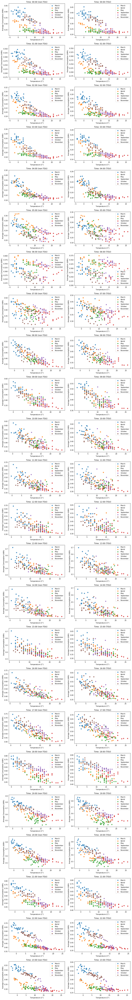

In [15]:
# Deeper look at Spring and Autumn
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
spring_autumn = [3, 4, 5, 9, 10, 11]
label_spr_aut = ['March', 'Aprial', 'May', 'September', 'October', 'November']
df_month_help = pd.DataFrame(pd.to_datetime(df_tariff_1h.GMT).dt.month)
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
lm = LinearRegression()
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + 1))
    if i <= 9:
        for j in range(len(spring_autumn)):
            df_wea1h_month = df_wea1h[df_month_help['GMT'] == spring_autumn[j]]
            df_Ntou1h_month = df_Ntou1h[df_month_help['GMT'] == spring_autumn[j]]
            x = df_wea1h_month.TempC[df_wea1h_month.GMT.str.contains('0' + str(i) + ':00:00')].values
            y = df_Ntou1h_month.Average[df_Ntou1h_month.GMT.str.contains('0' + str(i) + ':00:00')].values
            ax_Ntou[-1].scatter(x, y, label = label_spr_aut[j], alpha = 0.8)
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        for j in range(len(spring_autumn)):
            df_wea1h_month = df_wea1h[df_month_help['GMT'] == spring_autumn[j]]
            df_Ntou1h_month = df_Ntou1h[df_month_help['GMT'] == spring_autumn[j]]
            x = df_wea1h_month.TempC[df_wea1h_month.GMT.str.contains(str(i) + ':00:00')].values
            y = df_Ntou1h_month.Average[df_Ntou1h_month.GMT.str.contains(str(i) + ':00:00')].values
            ax_Ntou[-1].scatter(x, y, label = label_spr_aut[j], alpha = 0.8)
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
for i in range(24):
    ax_tou.append(fig_all.add_subplot(24, 2, 2 * i + 2))
    if i <= 9:
        for j in range(len(spring_autumn)):
            df_wea1h_month = df_wea1h[df_month_help['GMT'] == spring_autumn[j]]
            df_tou1h_month = df_tou1h[df_month_help['GMT'] == spring_autumn[j]]
            x = df_wea1h_month.TempC[df_wea1h_month.GMT.str.contains('0' + str(i) + ':00:00')].values
            y = df_tou1h_month.Average[df_tou1h_month.GMT.str.contains('0' + str(i) + ':00:00')].values
            ax_tou[-1].scatter(x, y, label = label_spr_aut[j], alpha = 0.8)
        ax_tou[-1].set_title('Time: 0' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
    else:
        for j in range(len(spring_autumn)):
            df_wea1h_month = df_wea1h[df_month_help['GMT'] == spring_autumn[j]]
            df_tou1h_month = df_tou1h[df_month_help['GMT'] == spring_autumn[j]]
            x = df_wea1h_month.TempC[df_wea1h_month.GMT.str.contains(str(i) + ':00:00')].values
            y = df_tou1h_month.Average[df_tou1h_month.GMT.str.contains(str(i) + ':00:00')].values
            ax_tou[-1].scatter(x, y, label = label_spr_aut[j], alpha = 0.8)
        ax_tou[-1].set_title('Time: ' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
plt.tight_layout()

The above shows that the left upper parts of the pictures are always from November (Autumn) and March (Spring)

April & May (Spring) and Sep & Oct. (Autumn) are on the lower part of the pictures. 

November, March and Winter (Dec, Jan, Feb.), i.e., months of 11, 12, 1, 2, 3 are on the upper left part.

April & May, Sep & Oct, and Summer (Jun, July, August), i.e., months of 4, 5, 6, 7, 8, 9, 10 are on the lower (sometimes right) part

## Monthly average demand and monthly total demand

In [18]:
df_Ntou1h_month.Total.sum()

1292443.6039999998

In [20]:
df_Ntou1h_month.Total[df_Ntou1h_month.GMT.str.contains('0' + str(i) + ':00:00')].sum()

52187.92

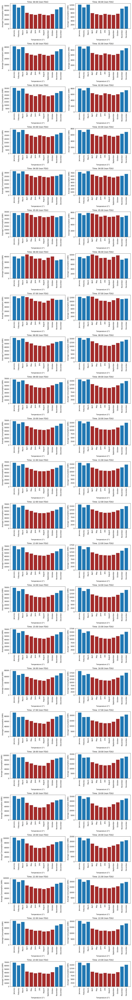

In [47]:
# Monthly total demand
month_n = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]
month_list = ['Janurary', 'Feburary', 'March', 'April', 'May', 'June', 
              'July', 'August', 'September', 'October', 'November', 'December']
color_dif = ['C0', 'C0', 'C0', 'brown', 'brown', 'brown', 
             'brown', 'brown', 'brown', 'brown', 'C0', 'C0']
df_month_help = pd.DataFrame(pd.to_datetime(df_tariff_1h.GMT).dt.month)
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
lm = LinearRegression()
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + 1))
    if i <= 9:
        month_hour_tot = []
        for j in range(len(month_n)):
            df_Ntou1h_month = df_Ntou1h[df_month_help['GMT'] == month_n[j]]
            month_hour_tot.append(df_Ntou1h_month.Total[df_Ntou1h_month.GMT.str.contains('0' + str(i) + ':00:00')].sum())        
        ax_Ntou[-1].bar(range(len(month_n)), month_hour_tot, color = color_dif)
        ax_Ntou[-1].set_xticks(range(len(month_n)))
        ax_Ntou[-1].set_xticklabels(month_list, rotation = 90)
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
    else:
        month_hour_tot = []
        for j in range(len(month_n)):
            df_Ntou1h_month = df_Ntou1h[df_month_help['GMT'] == month_n[j]]
            month_hour_tot.append(df_Ntou1h_month.Total[df_Ntou1h_month.GMT.str.contains(str(i) + ':00:00')].sum())
        ax_Ntou[-1].bar(range(len(month_n)), month_hour_tot, color = color_dif)
        ax_Ntou[-1].set_xticks(range(len(month_n)))
        ax_Ntou[-1].set_xticklabels(month_list, rotation = 90)
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
for i in range(24):
    ax_tou.append(fig_all.add_subplot(24, 2, 2 * i + 2))
    if i <= 9:
        month_hour_tot = []
        for j in range(len(month_n)):
            df_tou1h_month = df_tou1h[df_month_help['GMT'] == month_n[j]]
            month_hour_tot.append(df_tou1h_month.Total[df_tou1h_month.GMT.str.contains('0' + str(i) + ':00:00')].sum())        
        ax_tou[-1].bar(range(len(month_n)), month_hour_tot, color = color_dif)
        ax_tou[-1].set_xticks(range(len(month_n)))
        ax_tou[-1].set_xticklabels(month_list, rotation = 90)
        ax_tou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
    else:
        month_hour_tot = []
        for j in range(len(month_n)):
            df_tou1h_month = df_tou1h[df_month_help['GMT'] == month_n[j]]
            month_hour_tot.append(df_tou1h_month.Total[df_tou1h_month.GMT.str.contains(str(i) + ':00:00')].sum())
        ax_tou[-1].bar(range(len(month_n)), month_hour_tot, color = color_dif)
        ax_tou[-1].set_xticks(range(len(month_n)))
        ax_tou[-1].set_xticklabels(month_list, rotation = 90)
        ax_tou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
plt.tight_layout()

In [14]:
# Create Spring, Summer, Autumn and Winter dataframe for load, price, weather
spring = [3, 4, 5]
autumn = [9, 10, 11]
df_Ntou1h_Day = df_Ntou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == 0]
# df_Ntou1h_Mon = df_Ntou1h[df_day_help]
# df_wea1h_spr3 = df_wea1h[df_month_help['GMT'] == 3]
# df_tou1h_aut11 = df_tou1h[df_month_help['GMT'] == 11]

# df_Ntou1h_aut11 = df_Ntou1h[df_month_help['GMT'] == 11]
df_Ntou1h_Day

,GMT,N0000,N0001,N0002,N0003,N0004,N0005,N0006,N0007,N0008,...,N4166,N4167,N4168,N4169,N4170,N4171,N4172,Total,Average,TempC
144,2013-01-07 00:00:00,0.375,0.259,0.079,0.108,0.375,0.153,0.000,0.156,0.131,...,0.062,0.326,0.218,0.124,0.147,0.112,0.148,1496.822,0.358692,6.0
145,2013-01-07 01:00:00,0.324,0.266,0.037,0.157,0.268,0.088,0.000,0.158,0.156,...,0.021,0.161,0.213,0.095,0.145,0.113,0.152,1168.838,0.280095,6.0
146,2013-01-07 02:00:00,0.317,0.229,0.057,0.133,0.274,0.078,0.000,0.164,0.134,...,0.061,0.187,0.171,0.082,0.158,0.112,0.113,995.764,0.238621,5.0
147,2013-01-07 03:00:00,0.330,0.265,0.098,0.095,0.118,0.078,0.000,0.153,0.177,...,0.033,0.151,0.185,0.094,0.107,0.110,0.623,940.342,0.225340,5.0
148,2013-01-07 04:00:00,0.416,0.267,0.088,0.069,0.119,0.087,0.000,0.169,0.121,...,0.021,0.171,0.169,0.080,0.116,0.111,0.391,921.722,0.220878,5.0
149,2013-01-07 05:00:00,0.603,0.229,0.031,0.054,0.236,0.082,0.000,0.149,0.166,...,0.397,0.325,0.138,0.081,0.135,0.115,0.121,979.565,0.234739,5.0
150,2013-01-07 06:00:00,0.480,0.265,0.047,0.106,0.142,0.534,0.000,0.170,0.133,...,2.088,1.455,0.178,0.100,0.091,0.137,0.169,1212.790,0.290628,5.0
151,2013-01-07 07:00:00,0.524,0.265,0.099,0.157,0.117,0.968,0.000,0.149,0.235,...,3.334,1.367,0.261,0.086,0.123,0.156,0.380,1679.237,0.402405,5.0
152,2013-01-07 08:00:00,0.347,0.225,0.472,0.260,0.114,0.591,0.000,0.167,0.483,...,1.970,0.475,0.400,0.085,0.128,0.135,0.066,2024.244,0.485081,6.0
153,2013-01-07 09:00:00,0.351,0.261,0.195,0.570,0.405,0.222,0.000,0.147,0.480,...,0.507,0.659,0.296,0.256,0.081,0.110,0.109,2016.507,0.483227,6.0


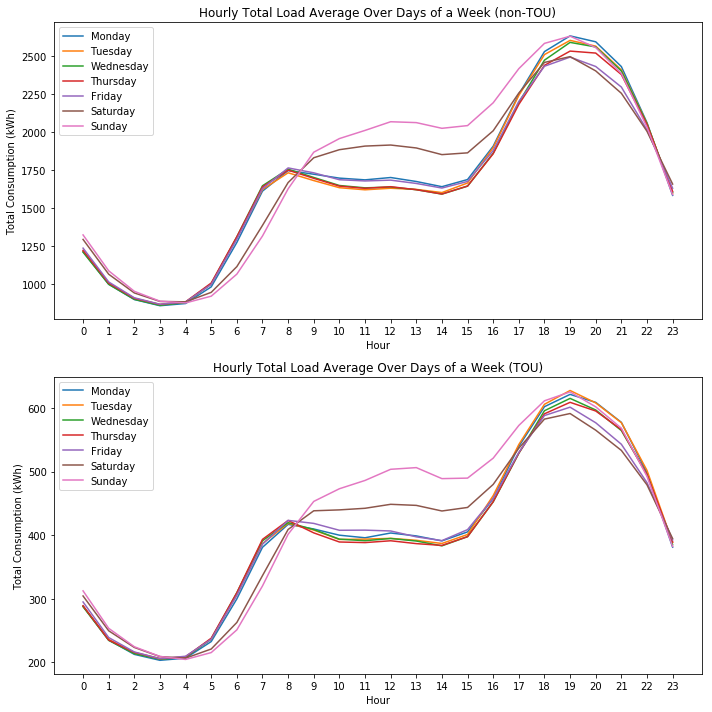

In [49]:
# Overview of the weekly patterns 
# non-TOU vs TOU in terms of showing the elements in Average column such 
# that they are hourly energy consumption over different days
# of a week for a whole year
week_days = [1, 2, 3, 4, 5, 6, 7]
label_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
# fig_all = plt.figure(figsize = (12,90))
fig_all = plt.figure(figsize = (10, 10))
ax = [] # store subplot objects

ax.append(fig_all.add_subplot(2, 1, 1))
for j in range(len(week_days)):
    df_Ntou1h_Day = df_Ntou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    df_tou1h_Day = df_tou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    hour_totload_avg = []
    for i in range(24):
        if i <= 9:
            hour_totload_avg.append(df_Ntou1h_Day.Total[df_Ntou1h.GMT.str.contains('0' + str(i) + ':00:00')].mean())
        else:
            hour_totload_avg.append(df_Ntou1h_Day.Total[df_Ntou1h.GMT.str.contains(str(i) + ':00:00')].mean())
    ax[-1].plot(range(24), hour_totload_avg, label = label_week[j])
ax[-1].set_title('Hourly Total Load Average Over Days of a Week (non-TOU)')
ax[-1].set_xlabel('Hour')
ax[-1].set_xticks(range(24))
ax[-1].set_ylabel('Total Consumption (kWh)')
ax[-1].legend()

ax.append(fig_all.add_subplot(2, 1, 2))
for j in range(len(week_days)):
    df_tou1h_Day = df_tou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    hour_totload_avg = []
    for i in range(24):
        if i <= 9:
            hour_totload_avg.append(df_tou1h_Day.Total[df_tou1h.GMT.str.contains('0' + str(i) + ':00:00')].mean())
        else:
            hour_totload_avg.append(df_tou1h_Day.Total[df_tou1h.GMT.str.contains(str(i) + ':00:00')].mean())
    ax[-1].plot(hour_totload_avg, label = label_week[j])
ax[-1].set_title('Hourly Total Load Average Over Days of a Week (TOU)')
ax[-1].set_xlabel('Hour')
ax[-1].set_xticks(range(24))
ax[-1].set_ylabel('Total Consumption (kWh)')
ax[-1].legend()
plt.tight_layout()

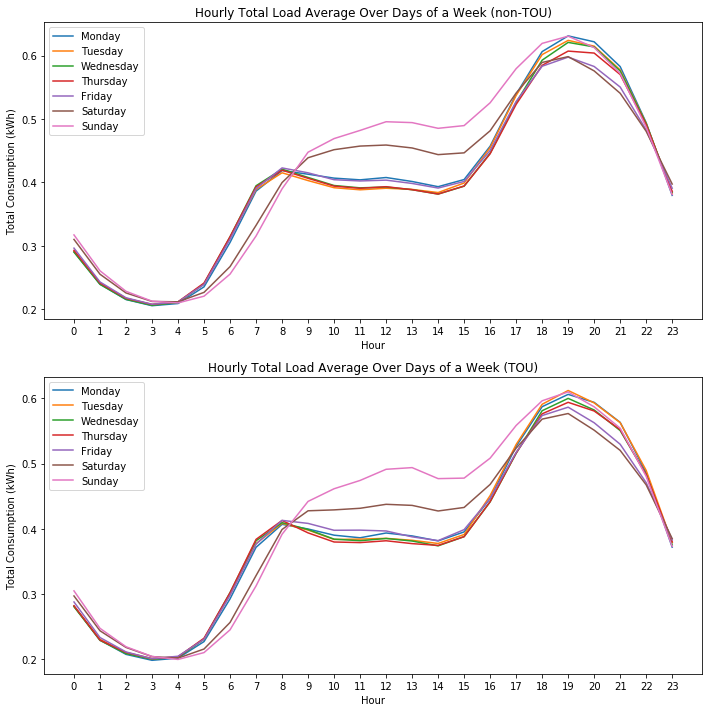

In [50]:
# Overview of the weekly patterns 
# non-TOU vs TOU in terms of showing the elements in Average column such 
# that they are hourly energy consumption over different days
# of a week for a whole year
week_days = [1, 2, 3, 4, 5, 6, 7]
label_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
# fig_all = plt.figure(figsize = (12,90))
fig_all = plt.figure(figsize = (10, 10))
ax = [] # store subplot objects

ax.append(fig_all.add_subplot(2, 1, 1))
for j in range(len(week_days)):
    df_Ntou1h_Day = df_Ntou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    df_tou1h_Day = df_tou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    hour_totload_avg = []
    for i in range(24):
        if i <= 9:
            hour_totload_avg.append(df_Ntou1h_Day.Average[df_Ntou1h.GMT.str.contains('0' + str(i) + ':00:00')].mean())
        else:
            hour_totload_avg.append(df_Ntou1h_Day.Average[df_Ntou1h.GMT.str.contains(str(i) + ':00:00')].mean())
    ax[-1].plot(range(24), hour_totload_avg, label = label_week[j])
ax[-1].set_title('Hourly Total Load Average Over Days of a Week (non-TOU)')
ax[-1].set_xlabel('Hour')
ax[-1].set_xticks(range(24))
ax[-1].set_ylabel('Total Consumption (kWh)')
ax[-1].legend()

ax.append(fig_all.add_subplot(2, 1, 2))
for j in range(len(week_days)):
    df_tou1h_Day = df_tou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    hour_totload_avg = []
    for i in range(24):
        if i <= 9:
            hour_totload_avg.append(df_tou1h_Day.Average[df_tou1h.GMT.str.contains('0' + str(i) + ':00:00')].mean())
        else:
            hour_totload_avg.append(df_tou1h_Day.Average[df_tou1h.GMT.str.contains(str(i) + ':00:00')].mean())
    ax[-1].plot(hour_totload_avg, label = label_week[j])
ax[-1].set_title('Hourly Total Load Average Over Days of a Week (TOU)')
ax[-1].set_xlabel('Hour')
ax[-1].set_xticks(range(24))
ax[-1].set_ylabel('Total Consumption (kWh)')
ax[-1].legend()
plt.tight_layout()

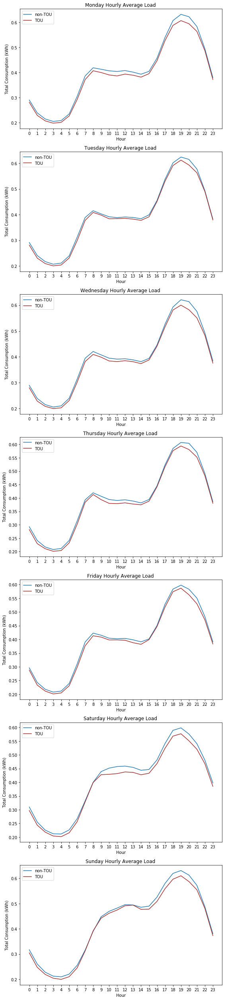

In [64]:
# Overview of the weekly patterns do it one day of TOU by one day of non-TOU
# non-TOU vs TOU in terms of showing the elements in Average column such 
# that they are hourly energy consumption over different days
# of a week for a whole year
week_days = [1, 2, 3, 4, 5, 6, 7]
label_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over 365 days
# fig_all = plt.figure(figsize = (12,90))
fig_all = plt.figure(figsize = (8, 35))
ax = [] # store subplot objects

for j in range(len(week_days)):
    ax.append(fig_all.add_subplot(7, 1, j+1))
    df_Ntou1h_Day = df_Ntou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    df_tou1h_Day = df_tou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    hour_totload_avg = []
    for i in range(24):
        if i <= 9:
            hour_totload_avg.append(df_Ntou1h_Day.Average[df_Ntou1h.GMT.str.contains('0' + str(i) + ':00:00')].mean())
        else:
            hour_totload_avg.append(df_Ntou1h_Day.Average[df_Ntou1h.GMT.str.contains(str(i) + ':00:00')].mean())
    ax[-1].plot(range(24), hour_totload_avg, label = 'non-TOU', color = 'C0')

    df_tou1h_Day = df_tou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    hour_totload_avg = []
    for i in range(24):
        if i <= 9:
            hour_totload_avg.append(df_tou1h_Day.Average[df_tou1h.GMT.str.contains('0' + str(i) + ':00:00')].mean())
        else:
            hour_totload_avg.append(df_tou1h_Day.Average[df_tou1h.GMT.str.contains(str(i) + ':00:00')].mean())
    ax[-1].plot(hour_totload_avg, label = 'TOU', color = 'brown')
    ax[-1].set_title(label_week[j] + ' Hourly Average Load ')
    ax[-1].set_xlabel('Hour')
    ax[-1].set_xticks(range(24))
    ax[-1].set_ylabel('Total Consumption (kWh)')
    ax[-1].legend()
plt.tight_layout()

## Compare the two groups in the non-flexible time periods
It's worth mentioning that TOU tariffs: 

high 0.672, default 0.1176, low 0.0399; non-TOU tariff is fixed 0.14228.

Read the tariff data and use it to filter out the time that has no event tags and compare the TOU data at those time periods with the corresponding non-TOU data. There are two things that need to pay attention. 

1) The tariff data is starting from 1/1/2013 0:30, which means from 0:00 to 0:30 the price is listed in the row of 1/1/2013 0:30. This is kind of different from TOU data, which is listed at the begining of the 30min intervals. So we need to first convert it to be consistent with TOU timing format.

2) Since TOU is notified one day ahead, it would be better we could filter out the whole day data that have TOU events. The high, low rate may affect the demand schedule of that day instead of only when high, low rate appear.

Next, we need to filter out the data that belongs to any event data

In [22]:
test=datetime.strptime(df_tariff_1h.GMT[0], "%Y-%m-%d %H:%M:%S")
test.second

0

In [67]:
# first, create a list of days that belongs to event days
event_days = set()
event_series = df_tariff_1h[df_tariff_1h.Event_tags.notnull()].GMT
for i in event_series:
    event_days.add(datetime.strptime(i[:10], "%Y-%m-%d" ).date()) # add all event dates to the set
df_help = pd.DataFrame(pd.to_datetime(df_tariff_1h.GMT).dt.date) #str to datatime and extract date then make it to dataframe
# df_help[df_help['GMT'].isin(event_days)] #this shows the event days
# we can use ~df_help['GMT'].isin(event_days) to generate any non-flexible period items

# create TOU and non-TOU demand data in non-flexible hours
df_wea1h_nf = df_wea1h[~df_help['GMT'].isin(event_days)]
df_Ntou1h_nf = df_Ntou1h[~df_help['GMT'].isin(event_days)]
df_tou1h_nf = df_tou1h[~df_help['GMT'].isin(event_days)]

In [9]:
df_tou1h_nf.head()

,GMT,D0000,D0001,D0002,D0003,D0004,D0005,D0006,D0007,D0008,...,D1015,D1016,D1017,D1018,D1019,D1020,D1021,D1022,D1023,D1024
0,2013-01-01 00:00:00,1.447,0.429,0.451,0.155,0.397,0.106,0.307,0.268,0.390,...,0.048,0.033,0.502,0.117,0.378,1.143,0.155,0.343,0.176,0.117
1,2013-01-01 01:00:00,0.336,0.377,0.467,0.153,0.227,0.109,0.365,0.300,0.528,...,0.062,0.010,0.528,0.117,0.399,0.856,0.098,0.278,0.334,0.127
2,2013-01-01 02:00:00,0.244,0.151,0.490,0.154,0.126,0.108,0.060,0.197,0.150,...,0.032,0.010,0.217,0.310,0.362,0.521,0.083,0.088,0.162,0.136
3,2013-01-01 03:00:00,0.213,0.155,0.580,0.153,0.057,0.109,0.067,0.167,0.151,...,0.062,0.011,0.206,0.119,0.368,0.470,0.113,0.061,0.127,0.247
4,2013-01-01 04:00:00,0.210,0.121,0.579,0.156,0.061,0.107,0.056,0.144,0.133,...,0.061,0.096,0.482,0.118,0.354,0.246,0.097,0.058,0.039,0.074


Now Let's plot the non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over non-event days

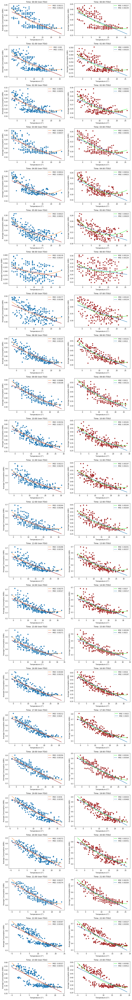

In [25]:
# Regression for non-event data
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
# non-TOU vs TOU in terms of showing the elements in Average column such that they are hourly energy consumption v.s. temperature over non-event days
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
lm = LinearRegression()
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + 1))
    if i <= 9:
        x = df_wea1h_nf.TempC[df_wea1h_nf.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_Ntou1h_nf.Average[df_Ntou1h_nf.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        x = df_wea1h_nf.TempC[df_wea1h_nf.GMT.str.contains(str(i) + ':00:00')].values
        y = df_Ntou1h_nf.Average[df_Ntou1h_nf.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_Ntou[-1].scatter(x, y)
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00 (non-TOU)')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
for i in range(24):
    ax_tou.append(fig_all.add_subplot(24, 2, 2 * i + 2))
    if i <= 9:
        x = df_wea1h_nf.TempC[df_wea1h_nf.GMT.str.contains('0' + str(i) + ':00:00')].values
        y = df_tou1h_nf.Average[df_tou1h_nf.GMT.str.contains('0' + str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: 0' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
    else:
        x = df_wea1h_nf.TempC[df_wea1h_nf.GMT.str.contains(str(i) + ':00:00')].values
        y = df_tou1h_nf.Average[df_tou1h_nf.GMT.str.contains(str(i) + ':00:00')].values
        xp = np.linspace(min(x), max(x), 50) # polynomial regression
        z = np.polyfit(x, y, 2)
        p = np.poly1d(z)
        ax_tou[-1].plot(xp, p(xp), color = 'lime', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
        x = x.reshape(-1, 1)
        y = y.reshape(-1, 1)
        lm.fit(x, y)
        ax_tou[-1].plot(x, lm.predict(x), label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
        ax_tou[-1].scatter(x, y, color = 'brown')
        ax_tou[-1].set_title('Time: ' + str(i) + ':00 (TOU)')
        ax_tou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_tou[-1].set_ylabel('Average Consumption (kWh)')
        ax_tou[-1].legend()
plt.tight_layout()

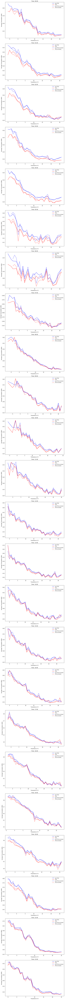

In [78]:
# non-TOU vs TOU in terms of average (over both users and the time) hourly energy consumption v.s. temperature in non-Event days
fig_all = plt.figure(figsize = (10,150))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 1, i+1))
    if i <= 9:
        # calculate the average consumption grouped by different temperatures
        df_NdVSt = df_Ntou1h[df_Ntou1h.GMT.str.contains('0' + str(i) + ':00:00')] #non-tou demand vs temperature
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total, c = 'blue', label = 'non-TOU' )
        
        df_dVSt = df_tou1h[df_tou1h.GMT.str.contains('0' + str(i) + ':00:00')]
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'red', label = 'TOU' )
        
        df_NdVSt = df_Ntou1h_nf[df_Ntou1h_nf.GMT.str.contains('0' + str(i) + ':00:00')] #non-tou demand vs temperature for non-Event
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total, c = 'blue', label = 'non-TOU no-Event', linestyle='dashed' )
        
        df_dVSt = df_tou1h_nf[df_tou1h_nf.GMT.str.contains('0' + str(i) + ':00:00')]
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'red', label = 'TOU no-Event', linestyle='dashed')# TOU demand vs temperature for non-Event
        
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        df_NdVSt = df_Ntou1h[df_Ntou1h.GMT.str.contains(str(i) + ':00:00')]
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total, c = 'blue', label = 'non-TOU')
        
        df_dVSt = df_tou1h[df_tou1h.GMT.str.contains(str(i) + ':00:00')]
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'red', label = 'TOU' )
        
        df_NdVSt = df_Ntou1h_nf[df_Ntou1h_nf.GMT.str.contains(str(i) + ':00:00')]
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total, c = 'blue', label = 'non-TOU no-Event', linestyle='dashed' ) #non-tou demand vs temperature for non-Event
        
        df_dVSt = df_tou1h_nf[df_tou1h_nf.GMT.str.contains(str(i) + ':00:00')]
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'red', label = 'TOU no-Event', linestyle='dashed' )# TOU demand vs temperature for non-Event
        
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
plt.tight_layout()

When there's no event, the fluctuation patterns of TOU (i.e., default price 0.1176 in this case) and non-TOU (0.14228) are quite similar, except for a gap. It's worth to analyze the reasons of the gap. Since we have removed effects of price fluctuation, both are fixed prices in TOU and non-TOU, the only difference could be 1) different price values, 0.1176 (TOU) vs 0.14228 (non-TOU); 2) different appliance usage characteristic between TOU group and non-TOU group; 3) others(like attitude, incomes etc.) And the later two reasons seems more reasonable, since non-TOU price 0.14228 > 0.1176 (TOU), but the consumption of non-TOU more  than the TOU case, which is counter intuitive. If two groups have simliar preference, then they would consume more when price is lower.

The similar patterns give us some evidence that our approach of removing event days (removing one day seems enough) kind of filters out effects of price changes to the consumption in TOU case. Thus, we can now compare event days' consumption when pricing changing happens with the non-Event TOU consumption.

Now let's compare the average TOU consumption in event periods, i.e., high-price or low-price periods with the no-event periods, and see how the price change affects the consumption.

In [68]:
# High price periods high 0.672 vs. default 0.1176 and low 0.0399
# Note: CM events only use high and low prices, so when we pick the high price and low price periods,
# those in CM will also be picked.
# first, create a list of days that belongs to event days
h_event_time = set()
df_event = df_tariff_1h[df_tariff_1h.Event_tags.notnull()]
# df_Ntou1h_hPrice = df_Ntou1h[df_tariff_1h.Price == 0.672]
# df_Ntou1h_lPrice = df_Ntou1h[df_tariff_1h.Price == 0.0399]
df_tou1h_hPrice = df_tou1h[df_tariff_1h.Price == 0.672]
df_tou1h_lPrice = df_tou1h[df_tariff_1h.Price == 0.0399]

# All event day's dataframe
df_help_event = df_tariff_1h[df_help['GMT'].isin(event_days)]
# the dataframe in event days with default price
df_help_event = df_help_event[df_help_event.Price == 0.1176] 
# TOU dataframe corresponding to these default price in event days
df_tou1h_eventday_dPrice = df_tou1h.loc[df_help_event.index] 

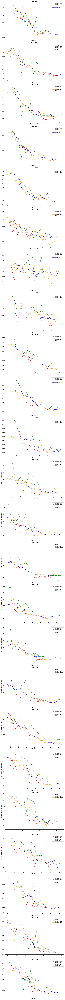

In [96]:
# non-TOU vs TOU in terms of average (over both users and the time) hourly energy consumption v.s. temperature
fig_all = plt.figure(figsize = (10,150))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 1, i+1))
    if i <= 9:
        # calculate the average consumption grouped by different temperatures
        df_dVSt = df_tou1h_hPrice[df_tou1h_hPrice.GMT.str.contains('0' + str(i) + ':00:00')] #TOU demand vs temperature for high price periods
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'red', label = 'TOU High Price', linestyle='dashed' )
        
        df_NdVSt = df_tou1h_lPrice[df_tou1h_lPrice.GMT.str.contains('0' + str(i) + ':00:00')] #TOU demand vs temperature for low price periods
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total, c = 'green', label = 'TOU Low Price', linestyle='dashed' )
        
        df_NdVSt = df_tou1h_eventday_dPrice[df_tou1h_eventday_dPrice.GMT.str.contains('0' + str(i) + ':00:00')] #TOU demand vs temperature for default price periods
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total, c = 'orange', label = 'TOU Default Price' )
        
        df_dVSt = df_tou1h_nf[df_tou1h_nf.GMT.str.contains('0' + str(i) + ':00:00')]
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'blue', label = 'TOU no-Event')# TOU demand vs temperature for non-Event
        
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        df_dVSt = df_tou1h_hPrice[df_tou1h_hPrice.GMT.str.contains(str(i) + ':00:00')] #TOU demand vs temperature for high price periods
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'red', label = 'TOU High Price', linestyle='dashed')
        
        df_NdVSt = df_tou1h_lPrice[df_tou1h_lPrice.GMT.str.contains(str(i) + ':00:00')] #TOU demand vs temperature for low price periods
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total, c = 'green', label = 'TOU Low Price', linestyle='dashed' ) 
        
        df_NdVSt = df_tou1h_eventday_dPrice[df_tou1h_eventday_dPrice.GMT.str.contains(str(i) + ':00:00')] #TOU demand vs temperature for default price periods
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total, c = 'orange', label = 'TOU Default Price' )
        
        df_dVSt = df_tou1h_nf[df_tou1h_nf.GMT.str.contains(str(i) + ':00:00')]
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'blue', label = 'TOU no-Event' )# TOU demand vs temperature for non-Event
        
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
plt.tight_layout()

The above figures tells us, the high price (red) usually appears in daytime or evening, and seldomly appears in a midnight (can add figures to visualize this) since red curves have less turning points, thus possible data points are less during midnight for the high pricing periods.

Also, during midnight, high pricing seems not to affect the average consumption too much (probably because people go to sleep, not too much consumption needed thus small flexibility on energy consumption at this time)

But from 9am to 11pm, the red curves are in general below blue curve, meaning that during the daytime(late morning) and evening, people's behavior are affected by high pricing, i.e., people tends to decrease their consumption.

Interestingly, for low pricing, it seems to work over all day night and more effective than high pricing in terms of affecting user's consumption. People tend to increase their consumption in general during low pricing. During daytime and evening it works best, for midnight it still has effect and more significant than high pricing.

The third thing needs to be mentioned is that around 6am, things become unclear, so 6am seems to be involved in more randomness of behavior. We could look deeper on that.

## Using non-TOU data with the constant shift to compare with the TOU data at the same flexible (event) time periods. 
Note that this cannot be done with TOU data, since at the same time and day of the event time, TOU group all facing the same price, it's impossible to compare with them at this time with a lower price, but we can compare with a counterpart with removing the constant difference.

In [87]:
# Calculate the average shift between TOU and non-TOU in non-event time, which reflects their intrinsic difference.
# non-TOU vs TOU in terms of average (over both users and the time) hourly energy consumption v.s. temperature in non-Event days
const_shift = [] # store constant shift between non-TOU and TOU, note: in this case it's non-TOU minus TOU
for i in range(24):
    if i <= 9:
        # calculate the average consumption grouped by different temperatures
        df_NdVSt = df_Ntou1h_nf[df_Ntou1h_nf.GMT.str.contains('0' + str(i) + ':00:00')] #non-tou demand vs temperature for non-Event
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        
        df_dVSt = df_tou1h_nf[df_tou1h_nf.GMT.str.contains('0' + str(i) + ':00:00')]
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()

        const_shift.append((df_NdVSt.Total - df_dVSt.Total).mean())
    else:
        df_NdVSt = df_Ntou1h_nf[df_Ntou1h_nf.GMT.str.contains(str(i) + ':00:00')]
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        
        df_dVSt = df_tou1h_nf[df_tou1h_nf.GMT.str.contains(str(i) + ':00:00')]
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        
        const_shift.append((df_NdVSt.Total - df_dVSt.Total).mean())

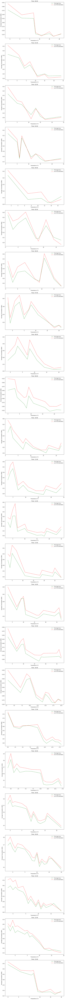

In [102]:
# TOU high price vs estimation of TOU group facing default price using non-TOU data
# hourly energy consumption v.s. temperature in event days
fig_all = plt.figure(figsize = (10,150))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 1, i+1))
    if i <= 9:
        # calculate the average difference between two 
        # calculate the average consumption grouped by different temperatures
        df_dVSt = df_tou1h_hPrice[df_tou1h_hPrice.GMT.str.contains('0' + str(i) + ':00:00')] #TOU demand vs temperature for high price periods
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'green', label = 'TOU High Price', linestyle='dashed' )
        
        df_NdVSt_help = df_Ntou1h[df_tariff_1h.Price == 0.672]
        df_NdVSt = df_NdVSt_help[df_NdVSt_help.GMT.str.contains('0' + str(i) + ':00:00')] # estimation of TOU group facing default price using non-TOU data
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total - const_shift[i], c = 'red', label = 'non-TOU Estimation', linestyle='dashed' )
        
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        df_dVSt = df_tou1h_hPrice[df_tou1h_hPrice.GMT.str.contains(str(i) + ':00:00')] #TOU demand vs temperature for high price periods
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'green', label = 'TOU High Price', linestyle='dashed')
        
        df_NdVSt_help = df_Ntou1h[df_tariff_1h.Price == 0.672]
        df_NdVSt = df_NdVSt_help[df_NdVSt_help.GMT.str.contains(str(i) + ':00:00')] # estimation of TOU group facing default price using non-TOU data
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total - const_shift[i], c = 'red', label = 'non-TOU Estimation', linestyle='dashed' ) 
        
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
plt.tight_layout()

In [108]:
# High price periods high 0.672 vs. default 0.1176 and low 0.0399
# Note: CM events only use high and low prices, so when we pick the high price and low price periods,
# those in CM will also be picked.
# first, create a list of days that belongs to event days
h_event_time = set()
df_event = df_tariff_1h[df_tariff_1h.Event_tags.notnull()]
# df_Ntou1h_hPrice = df_Ntou1h[df_tariff_1h.Price == 0.672]
# df_Ntou1h_lPrice = df_Ntou1h[df_tariff_1h.Price == 0.0399]
df_tou1h_hPrice = df_tou1h[df_tariff_1h.Price == 0.672]
df_tou1h_lPrice = df_tou1h[df_tariff_1h.Price == 0.0399]

# All event day's dataframe
df_help_event = df_tariff_1h[df_help['GMT'].isin(event_days)]
# the dataframe in event days with default price
df_help_event = df_help_event[df_help_event.Price == 0.1176] 
# TOU dataframe corresponding to these default price in event days
df_tou1h_eventday_dPrice = df_tou1h.loc[df_help_event.index] 

In [114]:
df_NdVSt_help = df_Ntou1h[df_help['GMT'].isin(event_days)]
df_NdVSt_help

,GMT,N0000,N0001,N0002,N0003,N0004,N0005,N0006,N0007,N0008,...,N4166,N4167,N4168,N4169,N4170,N4171,N4172,Total,Average,TempC
72,2013-01-04 00:00:00,0.354,0.265,0.083,0.097,0.634,0.125,0.000,0.169,0.116,...,0.037,0.352,0.189,0.173,0.168,0.020,0.330,1568.408,0.375847,7.0
73,2013-01-04 01:00:00,0.296,0.231,0.097,0.089,0.595,0.079,0.000,0.151,0.146,...,0.059,0.127,0.193,0.109,0.154,0.023,0.142,1218.273,0.291942,7.0
74,2013-01-04 02:00:00,0.303,0.263,0.043,0.115,0.408,0.072,0.000,0.169,0.144,...,0.020,0.207,0.199,0.087,0.086,0.100,0.154,1041.804,0.249653,8.0
75,2013-01-04 03:00:00,0.362,0.266,0.032,0.143,0.158,0.074,0.000,0.151,0.130,...,0.021,0.131,0.190,0.078,0.144,0.114,0.218,962.501,0.230650,8.0
76,2013-01-04 04:00:00,0.326,0.243,0.106,0.059,0.136,0.080,0.000,0.169,0.131,...,0.075,0.250,0.173,0.078,0.108,0.112,0.535,927.756,0.222324,8.0
77,2013-01-04 05:00:00,0.345,0.252,0.091,0.054,0.116,0.102,0.000,0.152,0.117,...,0.773,0.140,0.184,0.107,0.120,0.110,0.147,962.454,0.230638,8.0
78,2013-01-04 06:00:00,0.650,0.263,0.030,0.070,0.116,0.395,0.000,0.168,0.153,...,2.840,1.492,0.211,0.079,0.140,0.109,0.161,1141.583,0.273564,8.0
79,2013-01-04 07:00:00,0.605,0.250,0.041,0.507,0.116,0.361,0.000,0.150,0.185,...,4.225,0.909,0.215,0.078,0.090,0.135,0.365,1499.933,0.359438,8.0
80,2013-01-04 08:00:00,0.336,0.242,0.652,1.307,0.118,0.329,0.000,0.166,0.449,...,2.781,1.191,0.319,0.090,0.142,0.287,0.058,1843.710,0.441819,8.0
81,2013-01-04 09:00:00,0.318,0.264,0.615,0.920,0.571,0.669,0.000,0.151,0.978,...,0.993,0.701,0.370,0.175,0.074,0.108,0.075,1943.946,0.465839,8.0


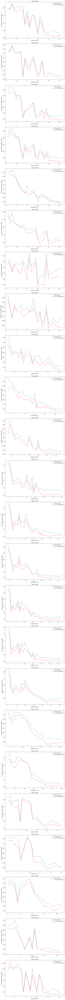

In [105]:
# TOU low price vs estimation of TOU group facing default price using non-TOU data 
# hourly energy consumption v.s. temperature in event days
fig_all = plt.figure(figsize = (10,150))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 1, i+1))
    if i <= 9:
        # calculate the average difference between two 
        # calculate the average consumption grouped by different temperatures
        df_dVSt = df_tou1h_lPrice[df_tou1h_lPrice.GMT.str.contains('0' + str(i) + ':00:00')] #TOU demand vs temperature for high price periods
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'C0', label = 'TOU Low Price', linestyle='dashed' )
        
        df_NdVSt_help = df_Ntou1h[df_tariff_1h.Price == 0.0399]
        df_NdVSt = df_NdVSt_help[df_NdVSt_help.GMT.str.contains('0' + str(i) + ':00:00')] # estimation of TOU group facing default price using non-TOU data (will remove the const difference later)
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total - const_shift[i], c = 'red', label = 'non-TOU Estimation', linestyle='dashed' )
        
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        df_dVSt = df_tou1h_lPrice[df_tou1h_lPrice.GMT.str.contains(str(i) + ':00:00')] #TOU demand vs temperature for high price periods
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'C0', label = 'TOU Low Price', linestyle='dashed')
        
        df_NdVSt_help = df_Ntou1h[df_tariff_1h.Price == 0.0399]
        df_NdVSt = df_NdVSt_help[df_NdVSt_help.GMT.str.contains(str(i) + ':00:00')] # estimation of TOU group facing default price using non-TOU data (will remove the const difference later)
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total - const_shift[i], c = 'red', label = 'non-TOU Estimation', linestyle='dashed' ) 
        
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
plt.tight_layout()

In [117]:
df_dVSt

,TempC,Total
0,-4.0,0.532086
1,-3.0,0.547714
2,-2.0,0.472577
3,0.0,0.524919
4,1.0,0.501798
5,2.0,0.444121
6,3.0,0.467437
7,4.0,0.435415
8,5.0,0.421515
9,6.0,0.398166


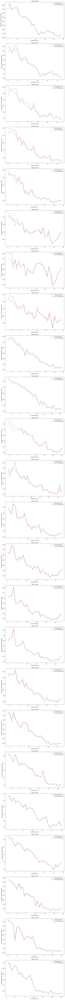

In [115]:
# TOU default price vs estimation of TOU group facing default price using non-TOU data 
# hourly energy consumption v.s. temperature in event days
fig_all = plt.figure(figsize = (10,150))
ax_Ntou = [] # store subplot objects
ax_tou = [] # store subplot objects
for i in range(24):
    ax_Ntou.append(fig_all.add_subplot(24, 1, i+1))
    if i <= 9:
        # calculate the average difference between two 
        # calculate the average consumption grouped by different temperatures
        df_dVSt = df_tou1h_eventday_dPrice[df_tou1h_eventday_dPrice.GMT.str.contains('0' + str(i) + ':00:00')] #TOU demand vs temperature for high price periods
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'C0', label = 'TOU Default Price', linestyle='dashed' )
        
        df_NdVSt_help1 = df_Ntou1h[df_help['GMT'].isin(event_days)]
        df_help2 = df_tariff_1h[df_help['GMT'].isin(event_days)]
        df_NdVSt_help = df_NdVSt_help1[df_help2.Price == 0.1176]
        df_NdVSt = df_NdVSt_help[df_NdVSt_help.GMT.str.contains('0' + str(i) + ':00:00')] # estimation of TOU group facing default price using non-TOU data (will remove the const difference later)
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total - const_shift[i], c = 'red', label = 'non-TOU Estimation', linestyle='dashed' )
        
        ax_Ntou[-1].set_title('Time: 0' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
    else:
        df_dVSt = df_tou1h_eventday_dPrice[df_tou1h_eventday_dPrice.GMT.str.contains(str(i) + ':00:00')] #TOU demand vs temperature for high price periods
        df_dVSt = df_dVSt.groupby('TempC')['Total'].mean() / (df_dVSt.shape[1] - 4)
        df_dVSt = df_dVSt.reset_index()
        ax_Ntou[-1].plot(df_dVSt.TempC, df_dVSt.Total,  c = 'C0', label = 'TOU Default Price', linestyle='dashed')
        
        df_NdVSt_help1 = df_Ntou1h[df_help['GMT'].isin(event_days)]
        df_help2 = df_tariff_1h[df_help['GMT'].isin(event_days)]
        df_NdVSt_help = df_NdVSt_help1[df_help2.Price == 0.1176]
        df_NdVSt = df_NdVSt_help[df_NdVSt_help.GMT.str.contains(str(i) + ':00:00')] # estimation of TOU group facing default price using non-TOU data (will remove the const difference later)
        df_NdVSt = df_NdVSt.groupby('TempC')['Total'].mean() / (df_NdVSt.shape[1] - 4)
        df_NdVSt = df_NdVSt.reset_index()
        ax_Ntou[-1].plot(df_NdVSt.TempC, df_NdVSt.Total - const_shift[i], c = 'red', label = 'non-TOU Estimation', linestyle='dashed' ) 
        
        ax_Ntou[-1].set_title('Time: ' + str(i) + ':00')
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Average Consumption (kWh)')
        ax_Ntou[-1].legend()
plt.tight_layout()

The above figures somehow shows that the estimation of TOU group facing default price using non-TOU data (removing the const difference) is close to the real TOU groupd facing default price. 

Study the household consumption types. We first take a look at how does the demand look like in differnt work days over a year 

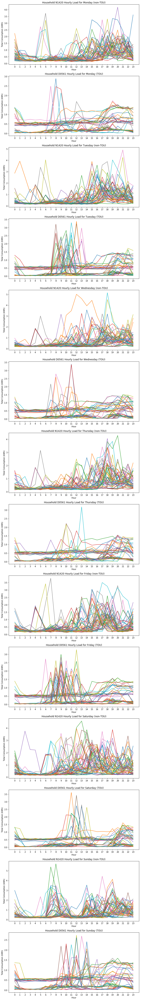

In [146]:
# We just randomly pick one non-TOU household and one TOU houdsehold
import random
id_Ntou = random.randint(0, df_Ntou1h.shape[1] - 3) #make sure number is in household index
id_tou = random.randint(0, df_tou1h.shape[1] - 3)
columns_Ntou = df_Ntou1h.columns.values[id_Ntou + 1] #name of the household
columns_tou = df_tou1h.columns.values[id_tou + 1]
# select all Monday data
week_days = [1, 2, 3, 4, 5, 6, 7]
label_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
fig_all = plt.figure(figsize = (10, 70))
ax = [] # store subplot objects

for j in range(len(week_days)):
    ax.append(fig_all.add_subplot(14, 1, 2 * j + 1))
    df_Ntou1h_Day = df_Ntou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    for i in range(int(df_Ntou1h_Day.shape[0] / 24)):
        ax[-1].plot(range(24), df_Ntou1h_Day[columns_Ntou].iloc[i * 24 : i * 24 + 24], label = label_week[j])
    ax[-1].set_title('Household ' + columns_Ntou + ' Hourly Load for ' + label_week[j]+ ' (non-TOU)')
    ax[-1].set_xlabel('Hour')
    ax[-1].set_xticks(range(24))
    ax[-1].set_ylabel('Total Consumption (kWh)')


for j in range(len(week_days)):
    ax.append(fig_all.add_subplot(14, 1, 2 * j + 2))
    df_tou1h_Day = df_tou1h[pd.to_datetime(df_tariff_1h.GMT).dt.weekday == j]
    for i in range(int(df_tou1h_Day.shape[0] / 24)):
        ax[-1].plot(range(24), df_tou1h_Day[columns_tou].iloc[i * 24 : i * 24 + 24], label = label_week[j])
    ax[-1].set_title('Household ' + columns_tou + ' Hourly Load for ' + label_week[j]+ ' (TOU)')
    ax[-1].set_xlabel('Hour')
    ax[-1].set_xticks(range(24))
    ax[-1].set_ylabel('Total Consumption (kWh)')
plt.tight_layout()

In [133]:
df_Ntou1h_Day.shape

(1248, 4177)

In [ ]:
import math
math.isnan(float('nan'))
# float('nan')

In [ ]:

temp_df_tariff[:-11]

In [ ]:
# Now we compress the rows such that the frequency is 1 hour
# first let's delete the GMT index of matrix consists in odd rows
odd_df_ntou = df_ntou_2013.loc[1::2].copy()
odd_df_ntou.loc[:, 'GMT'] = ''
# create the new dataframe that is the sum of odd and even rows
df_ntou_2013_1h = (df_ntou_2013[::2] + odd_df_ntou.values).reset_index(drop = True)
# store it to a csv file
df_ntou_2013_1h.to_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_Ntou2013_1h.csv", index = False)

## Study the consumer types, lifestyle for 6 am case and the seasonal effect and also .

## Next, we can add one more filtering condition, check the hourly relation in a specific day of a week over the whole year.

## Scaterplot the consumption-weather relationship for the non-TOU case

In [ ]:
x = np.arange(0, 2, 0.1)
# plt.plot(x, x, label = 'linear')
# plt.plot(x, x**2, label = 'quadratic')
fig, ax = plt.subplots(1,2)
ax[1].plot(x, x, 'ro',label = 'linear')
ax[1].legend()
ax[0].plot(x, x**2, label = 'quatratic')
ax[0].legend()
ax[0].xlabel('X axis')
ax[0].ylabel('Y axis')
plt.show()

In [ ]:
# We first right join the df_wea1h to df_Ntou1h.
df_touWea1h = pd.merge(df_Ntou1h, df_wea1h, on = 'GMT', how = 'right')

ax1 = df_touWea1h.plot.scatter(x = 'TempC', y = 'N0000', c = 'Blue')

### (Just a reminder, for Matplotlib the pandas data object may or may not work as intended, so it's better to convert array to np.array objects or np.ma.maksed_array objects as inputs.)